# Convolutional Neural Networks (classifier)



In [5]:
import numpy as np
from glob import glob

# load filenames for human and dog images
human_files = np.array(glob("lfw/*/*"))
dog_files = np.array(glob("dogImages/*/*/*"))

# print number of images in each dataset
print('There are %d total human images.' % len(human_files))
print('There are %d total dog images.' % len(dog_files))

There are 13233 total human images.
There are 8351 total dog images.


## Detect Humans

OpenCV's implementation of [Haar feature-based cascade classifiers](http://docs.opencv.org/trunk/d7/d8b/tutorial_py_face_detection.html) to detect human faces in images.  


Number of faces detected: 1


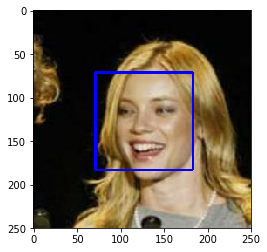

In [6]:
import cv2                
import matplotlib.pyplot as plt                        
%matplotlib inline                               

# extract pre-trained face detector
face_cascade = cv2.CascadeClassifier('haarcascades/haarcascade_frontalface_alt.xml')

# load color (BGR) image
img = cv2.imread(human_files[500])
# convert BGR image to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# find faces in image
faces = face_cascade.detectMultiScale(gray)

# print number of faces detected in the image
print('Number of faces detected:', len(faces))

# get bounding box for each detected face
for (x,y,w,h) in faces:
    # add bounding box to color image
    cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    
# convert BGR image to RGB for plotting
cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# display the image, along with bounding box
plt.imshow(cv_rgb)
plt.show()


### Write a Human Face Detector


In [7]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

In [8]:
def assess_face_detector(h_files, d_files):
    hf_detected_faces = 0.0
    df_detected_faces = 0.0

    for i in trange(len(h_files)):
        if face_detector(h_files[i]) > 0:
             hf_detected_faces += 1
        if face_detector(d_files[i]) > 0:
            df_detected_faces += 1

    print('Human faces detected in:')
    print(f'{(hf_detected_faces/len(h_files))*100}% of human_files and {(df_detected_faces /len(h_files))*100}% of dog_files')

In [9]:
from tqdm import trange

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

assess_face_detector(human_files_short, dog_files_short)

100%|██████████| 100/100 [00:11<00:00, 10.55it/s]

Human faces detected in:
96.0% of human_files and 18.0% of dog_files


---
## Detect Dogs

use a [pre-trained model](http://pytorch.org/docs/master/torchvision/models.html) to detect dogs in images.  

### Obtain Pre-trained VGG-16 Model



In [11]:
import torch
import torchvision.models as models

# define VGG-16 model
VGG16 = models.vgg16(pretrained=True)

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    VGG16 = VGG16.cuda()

Given an image, this pre-trained VGG-16 model returns a prediction (derived from the 1000 possible categories in ImageNet) for the object that is contained in the image.

### (IMPLEMENTATION) Making Predictions with a Pre-trained Model


In [42]:
from PIL import Image
from torchvision import transforms
from torch.autograd import Variable
import torch.nn as nn

# solves: OSError: image file is truncated (150 bytes not processed)
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

def VGG16_predict(img_path):
    '''
    Use pre-trained VGG-16 model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to VGG-16 model's prediction
    '''
    
    ## Complete the function.
    ## Load and pre-process an image from the given img_path
    ## Return the *index* of the predicted class for that image
    VGG16.eval()
    
    loader = transforms.Compose([transforms.Resize((224,224)),
                                 transforms.ToTensor(),
                                 transforms.Normalize((0.485, 0.456, 0.406),      # normalize image for pre-trained model
                                                      (0.229, 0.224, 0.225))])
    image = Image.open(img_path)
    image = loader(image).float()
    # needs to  be Variable to be accepted by VGG16
    image = Variable(image)
    # makes a mini-batch of size 1
    image = image.unsqueeze(0)  
    # get predictions, squeeze it out of the 'mini-batch', and return as numpy
    prediction = VGG16(image).squeeze().data.numpy()
    # np.argmax returns the position of the largest value
    return np.argmax(prediction)

VGG16_predict('dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg')

252

### (IMPLEMENTATION) Write a Dog Detector


In [8]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    imagenet_class = VGG16_predict(img_path)
    if imagenet_class >= 151 and imagenet_class <= 268:
        return True
    else:
        return False

### (IMPLEMENTATION) Assess the Dog Detector


In [1]:
def assess_dog_detector(h_files, d_files):
    hf_detected_dogs  = 0.0
    df_detected_dogs = 0.0

    for i in trange(len(d_files)):
        if dog_detector(h_files[i]) > 0:
             hf_detected_dogs += 1
        if dog_detector(d_files[i]) > 0:
            df_detected_dogs += 1
    
    print(f'Model: vgg16')
    print('Dogs detected in:')
    print(f'{(hf_detected_dogs/len(d_files))*100}% of human_files and {(df_detected_dogs/len(d_files))*100}% in dog_files')

In [11]:
### Test the performance of the dog_detector function
### on the images in human_files_short and dog_files_short.

human_files_short = human_files[:100]
dog_files_short = dog_files[:100]

assess_dog_detector(human_files_short, dog_files_short)

100%|██████████| 100/100 [02:21<00:00,  1.37s/it]

Model: vgg16
Dogs detected in:
0.0% of human_files and 93.0% in dog_files


## Assess the Dog Detector with more pre-trained networks


In [5]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector_2(img_path, model, model_name):
    imagenet_class = model_predict(img_path, model, model_name)
    if imagenet_class >= 151 and imagenet_class <= 268:
        return True
    else:
        return False

In [6]:
def assess_dog_detector_2(h_files, d_files, models_dict):
    
    for model_name, model in models_dict.items():
        hf_detected_dogs  = 0.0
        df_detected_dogs = 0.0
        for i in trange(len(d_files)):
            if dog_detector_2(h_files[i], model, model_name) > 0:
                 hf_detected_dogs += 1
            if dog_detector_2(d_files[i], model, model_name) > 0:
                df_detected_dogs += 1
    
        print(f'Model: {model_name}')
        print('Dogs detected in:')
        print(f'{(hf_detected_dogs/len(d_files))*100}% of human_files and {(df_detected_dogs/len(d_files))*100}% in dog_files\n')

In [25]:
def model_predict(img_path, model, model_name):
    '''
    Use pre-trained model to obtain index corresponding to 
    predicted ImageNet class for image at specified path
    
    Args:
        img_path: path to an image
        
    Returns:
        Index corresponding to model's prediction
    '''
    
    model.eval()
    
    if model_name == 'inception_v3':
        loader = transforms.Compose([transforms.Resize((299,299)),
                                     transforms.ToTensor()])
        model.transform_input = True
    else:
        loader = transforms.Compose([transforms.Resize((224,224)),
                                     transforms.ToTensor(),
                                     transforms.Normalize((0.485, 0.456, 0.406),      # normalize image for pre-trained model
                                                          (0.229, 0.224, 0.225))])
        
    image = Image.open(img_path)
    image = loader(image).float()
    # needs to  be Variable to be accepted by model
    image = Variable(image)
    # makes a mini-batch of size 1
    image = image.unsqueeze(0)  
    # get predictions, squeeze it out of the 'mini-batch', and return as numpy
    prediction = model(image).squeeze().data.numpy()
    # np.argmax returns the position of the largest value
    return np.argmax(prediction)

In [ ]:
# define pre-trained models
vgg16 = models.vgg16(pretrained=True)
vgg19_bn = models.vgg19_bn(pretrained=True)
alexnet = models.alexnet(pretrained=True)
resnet152 = models.resnet152(pretrained=True)
squeezenet1_1 = models.squeezenet1_1(pretrained=True)
densenet161 = models.densenet161(pretrained=True)
inception_v3 = models.inception_v3(pretrained=True)

models_dict = {'vgg16':vgg16, 'vgg19_bn':vgg19_bn, 'alexnet':alexnet, 'resnet152':resnet152,
                'squeezenet1_1':squeezenet1_1, 'densenet161':densenet161, 'inception_v3':inception_v3} 

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    vgg16 = vgg16.cuda()
    vgg19_bn = vgg19_bn.cuda()
    inception_v3 = inception_v3.cuda() 
    alexnet = alexnet.cuda() 
    resnet152 = resnet152.cuda() 
    squeezenet1_1 = squeezenet1_1.cuda() 
    densenet161 = densenet161.cuda() 
    inception_v3 = inception_v3.cuda() # define pre-trained models
vgg16 = models.vgg16(pretrained=True)
vgg19_bn = models.vgg19_bn(pretrained=True)
alexnet = models.alexnet(pretrained=True)
resnet152 = models.resnet152(pretrained=True)
squeezenet1_1 = models.squeezenet1_1(pretrained=True)
densenet161 = models.densenet161(pretrained=True)
inception_v3 = models.inception_v3(pretrained=True)

models_dict = {'vgg16':vgg16, 'vgg19_bn':vgg19_bn, 'alexnet':alexnet, 'resnet152':resnet152,
                'squeezenet1_1':squeezenet1_1, 'densenet161':densenet161, 'inception_v3':inception_v3} 

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    vgg16 = vgg16.cuda()
    vgg19_bn = vgg19_bn.cuda()
    inception_v3 = inception_v3.cuda() 
    alexnet = alexnet.cuda() 
    resnet152 = resnet152.cuda() 
    squeezenet1_1 = squeezenet1_1.cuda() 
    densenet161 = densenet161.cuda() 
    inception_v3 = inception_v3.cuda() 

In [17]:
human_files_short = human_files[:1000]
dog_files_short = dog_files[:1000]

assess_dog_detector_2(human_files_short, dog_files_short, models_dict)

  0%|          | 0/1000 [00:00<?, ?it/s]

Model: vgg16
Dogs detected in:
0.5% of human_files and 98.7% in dog_files



  0%|          | 0/1000 [00:00<?, ?it/s]

Model: vgg19_bn
Dogs detected in:
0.8999999999999999% of human_files and 98.5% in dog_files



  0%|          | 0/1000 [00:00<?, ?it/s]

Model: alexnet
Dogs detected in:
0.3% of human_files and 98.1% in dog_files



  0%|          | 0/1000 [00:00<?, ?it/s]

Model: resnet152
Dogs detected in:
1.0% of human_files and 98.1% in dog_files



  0%|          | 0/1000 [00:00<?, ?it/s]

Model: squeezenet1_1
Dogs detected in:
0.1% of human_files and 98.4% in dog_files



  0%|          | 0/1000 [00:00<?, ?it/s]

Model: densenet161
Dogs detected in:
0.6% of human_files and 98.8% in dog_files



100%|██████████| 1000/1000 [20:36<00:00,  1.14s/it]

Model: inception_v3
Dogs detected in:
0.5% of human_files and 98.4% in dog_files



In [28]:
# test more resnet models

human_files_short = human_files[:1000]
dog_files_short = dog_files[:1000]

# define pre-trained models
resnet18 = models.resnet18(pretrained=True)
resnet34 = models.resnet34 (pretrained=True)
resnet50 = models.resnet50(pretrained=True)
resnet101 = models.resnet101(pretrained=True)

models_dict = {'resnet18':resnet18, 'resnet34':resnet34, 'resnet50':resnet50, 'resnet101':resnet101} 

# check if CUDA is available
use_cuda = torch.cuda.is_available()

# move model to GPU if CUDA is available
if use_cuda:
    resnet18 = resnet18.cuda()
    resnet34 = resnet34.cuda()
    resnet50 = resnet50.cuda()
    resnet101 = resnet101.cuda()
    
human_files_short = human_files[:1000]
dog_files_short = dog_files[:1000]

assess_dog_detector_2(human_files_short, dog_files_short, models_dict)

  0%|          | 0/1000 [00:00<?, ?it/s]

Model: resnet18
Dogs detected in:
0.6% of human_files and 98.4% in dog_files



  0%|          | 0/1000 [00:00<?, ?it/s]

Model: resnet34
Dogs detected in:
0.7000000000000001% of human_files and 98.5% in dog_files



  0%|          | 0/1000 [00:00<?, ?it/s]

Model: resnet50
Dogs detected in:
0.8999999999999999% of human_files and 98.6% in dog_files



100%|██████████| 1000/1000 [27:12<00:00,  1.51s/it]

Model: resnet101
Dogs detected in:
0.8% of human_files and 98.6% in dog_files



---
 ## Create a CNN to Classify Dog Breeds (from Scratch)



### Load and Transform our Data

In [17]:
import os
import numpy as np
from torchvision import datasets, transforms
from torch import utils
import matplotlib.pyplot as plt
%matplotlib inline

# define training, validation and test data directories
data_dir = 'dogImages/'
train_dir = os.path.join(data_dir, 'train/')
valid_dir = os.path.join(data_dir, 'valid/')
test_dir = os.path.join(data_dir, 'test/')

# create transforms

data_transforms = {
    'train': transforms.Compose([
    transforms.RandomAffine(10, translate=[0.1, 0.1], shear=10),
    transforms.Resize((256,256)),
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(
            brightness=0.4,
            contrast=0.4,
            saturation=0.4,),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'val': transforms.Compose([
        transforms.Resize((230,230)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((230,230)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

# create datasets
train_data = datasets.ImageFolder(train_dir, transform=data_transforms['train'])
valid_data = datasets.ImageFolder(valid_dir, transform=data_transforms['val'])
test_data = datasets.ImageFolder(test_dir, transform=data_transforms['test'])

# print out some data stats
print(f'Number of training images: {len(train_data)}')
print(f'Number of validation images: {len(valid_data)}')
print(f'Number of test images: {len(test_data)}')

Number of training images: 6680
Number of validation images: 835
Number of test images: 836


### DataLoaders and Data Visualization

In [18]:
# define dataloader parameters
batch_size = 64
num_workers= 0

# prepare data loaders

train_loader = utils.data.DataLoader(train_data, batch_size=batch_size, 
                                           num_workers=num_workers, shuffle=True)
valid_loader = utils.data.DataLoader(valid_data, batch_size=batch_size, 
                                          num_workers=num_workers, shuffle=True)
test_loader = utils.data.DataLoader(test_data, batch_size=batch_size, 
                                          num_workers=num_workers, shuffle=True)

loaders_scratch = {'train':train_loader,'valid':valid_loader, 'test':test_loader}

In [19]:
def un_normalize(tensors, mean, std):
    for tensor in tensors:
        for t, m, s in zip(tensor, mean, std):
            t.mul_(s).add_(m)
    return tensors

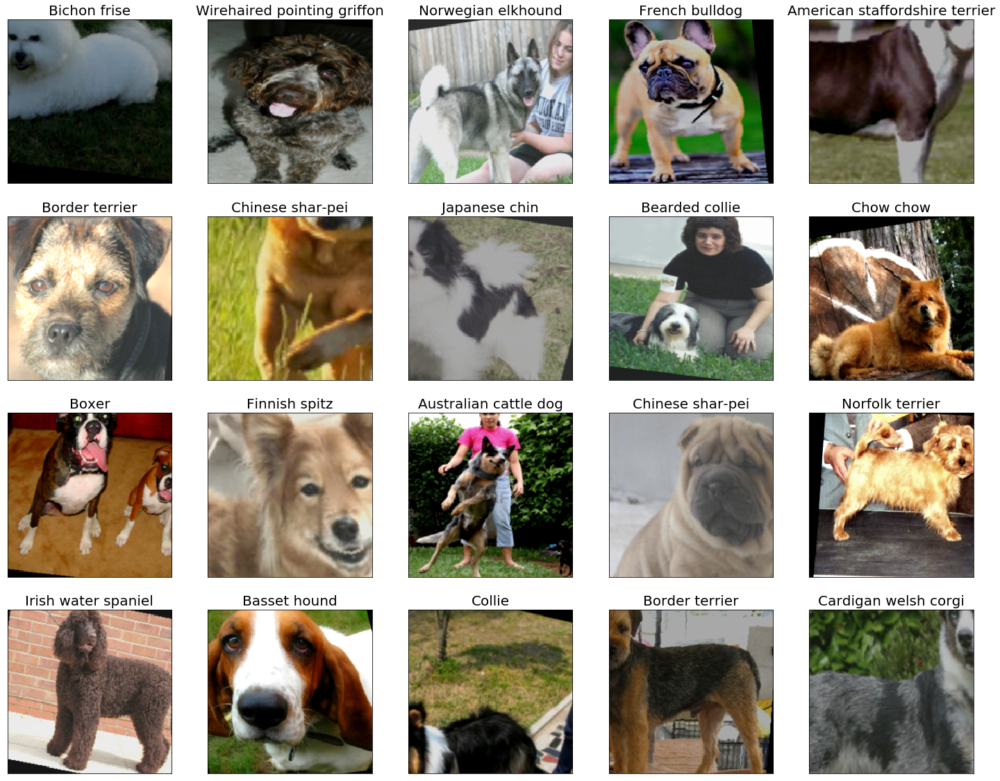

In [20]:
# Visualize some sample data

# obtain one batch
dataiter = iter(train_loader)
images, labels = dataiter.next()
images = un_normalize(images,mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
images = images.numpy() # convert from tesnor to numpy for disply

# get class names
class_names = [item[4:].replace("_", " ") for item in train_data.classes]

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(25, 20))
for idx in np.arange(20):
    ax = fig.add_subplot(4, 10/2, idx+1, xticks=[], yticks=[])
    plt.imshow(np.transpose(images[idx], (1, 2, 0)))
    ax.set_title(class_names[int(labels[idx])],fontsize=20)

In [21]:
print(f'Number of dog breeds: {len(train_data.classes)}')

Number of dog breeds: 133


### (IMPLEMENTATION) Model Architecture



In [22]:
import torch.nn as nn
import torch.nn.functional as F

def conv3x3(in_planes, out_planes, stride=1):
    """3x3 convolution with padding"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=1, bias=False)


def conv1x1(in_planes, out_planes, stride=1):
    """1x1 convolution"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=1, stride=stride, bias=False)


class BasicBlock(nn.Module):

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(BasicBlock, self).__init__()
        self.conv1 = conv3x3(inplanes, planes, stride)
        self.bn1 = nn.BatchNorm2d(planes)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = nn.BatchNorm2d(planes)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.relu(out)

        return out

# define the CNN architecture
class ResNet(nn.Module):
    ### choose an architecture, and complete the class
    def __init__(self, block, layers, num_classes=133):
        super(ResNet, self).__init__()
        self.inplanes = 16
        
        self.conv1 = nn.Conv2d(3, 16, kernel_size=7, stride=2, padding=3,bias=False)
        self.bn1 = nn.BatchNorm2d(16)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.layer1 = self._make_layer(block, 16, layers[0])
        self.layer2 = self._make_layer(block, 32, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 64, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 128, layers[3], stride=2)
        
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(128, num_classes)

        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
                
    def _make_layer(self, block, planes, blocks, stride=1):
        downsample = None
        if stride != 1 or self.inplanes != planes:
            downsample = nn.Sequential(
                conv1x1(self.inplanes, planes, stride),
                nn.BatchNorm2d(planes),
            )

        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample))
        self.inplanes = planes
        for _ in range(1, blocks):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        x = self.avgpool(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)

        return x
    
# instantiate the CNN
model_scratch = ResNet(BasicBlock, [2, 2, 2, 2])

# move tensors to GPU if CUDA is available
if use_cuda:
    model_scratch.cuda()
    
print(model_scratch)

ResNet(
  (conv1): Conv2d(3, 16, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (conv2): Co

## Loss Function and Optimizer


In [23]:
import torch.optim as optim
from torch.optim import lr_scheduler

### select loss function
criterion_scratch = nn.CrossEntropyLoss()

### select optimizer
optimizer_scratch = optim.Adam(params=model_scratch.parameters(), lr=0.001)

# reduce learning rate when a validation loss has stopped improving
plateau_lr_scheduler = lr_scheduler.ReduceLROnPlateau(optimizer_scratch, 'min',  patience=7, verbose=True)

### Train and Validate the Model



In [24]:
class EarlyStopping:
    """Early stops the training if validation loss dosen't improve after a given patience."""
    def __init__(self,patience=5):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved. 
        """
        self.patience = patience
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
    
    def __call__(self, val_loss, model):
        
        score = -val_loss
        
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score:
            self.counter += 1
            print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0
    
    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decrease.'''
        print(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), 'saved_models/checkpoint.pt')
        self.val_loss_min = val_loss

In [25]:
from tqdm import trange
# solves: OSError: image file is truncated (150 bytes not processed)
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

def train(n_epochs, loaders, model, optimizer, criterion, use_cuda, save_path, scheduler, patience=15):
    """returns trained model"""
    early_stopping = EarlyStopping(patience=patience)
    # initialize tracker for minimum validation loss
    valid_loss_min = np.Inf 
    
    for epoch in trange(1, n_epochs+1):
        # initialize variables to monitor training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        
        ###################
        # train the model #
        ###################
        model.train()
        for batch_idx, (data, target) in enumerate(loaders['train']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## record the average training loss
            
            # clear the gradients of all optimized variables
            optimizer.zero_grad()
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # backward pass: compute gradient of the loss with respect to the model
            loss.backward()
            # perform a single optimization step (parameter update)
            optimizer.step()
            # update training loss 
            train_loss +=  ((1 / (batch_idx + 1)) * (loss.data - train_loss))
            
        ######################    
        # validate the model #
        ######################
        model.eval()
        for batch_idx, (data, target) in enumerate(loaders['valid']):
            # move to GPU
            if use_cuda:
                data, target = data.cuda(), target.cuda()
            ## update the average validation loss
            # forward pass to get net output
            output = model(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # update validation loss 
            valid_loss +=  ((1 / (batch_idx + 1)) * (loss.data - valid_loss))
        
        scheduler.step(valid_loss)
        # print training/validation statistics 
        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))
        
        early_stopping(valid_loss, model)
        
        if early_stopping.early_stop:
            print("Early stopping")
            break
            
    # load last checkpoint with the best model
    model.load_state_dict(torch.load('saved_models/checkpoint.pt'))
    best_vloss = -early_stopping.best_score
    torch.save(model.state_dict(), f'{save_path}_vloss{best_vloss:.5f}.pt')
    print('Finished Training')
    # return trained model
    return model

In [ ]:
# train the model
model_scratch = train(500, loaders_scratch, model_scratch, optimizer_scratch, 
                      criterion_scratch, use_cuda, 'saved_models/model_scratch',
                      plateau_lr_scheduler , patience=15)


  0%|          | 1/500 [02:22<19:47:21, 142.77s/it]

Epoch: 1 	Training Loss: 4.844275 	Validation Loss: 4.797740


  0%|          | 2/500 [04:45<19:44:39, 142.73s/it]

Epoch: 2 	Training Loss: 4.646862 	Validation Loss: 4.757406
Validation loss decreased (inf --> 4.757406).  Saving model ...


  1%|          | 3/500 [07:07<19:41:28, 142.63s/it]

Epoch: 3 	Training Loss: 4.537614 	Validation Loss: 4.484524
Validation loss decreased (4.757406 --> 4.484524).  Saving model ...


  1%|          | 4/500 [09:30<19:38:21, 142.54s/it]

Epoch: 4 	Training Loss: 4.398640 	Validation Loss: 4.363810
Validation loss decreased (4.484524 --> 4.363810).  Saving model ...


  1%|          | 5/500 [11:55<19:41:56, 143.27s/it]

Epoch: 5 	Training Loss: 4.263115 	Validation Loss: 4.381573
EarlyStopping counter: 1 out of 15


  1%|          | 6/500 [14:17<19:37:52, 143.06s/it]

Epoch: 6 	Training Loss: 4.150416 	Validation Loss: 4.094526
Validation loss decreased (4.363810 --> 4.094526).  Saving model ...


  1%|▏         | 7/500 [16:40<19:33:51, 142.86s/it]

Epoch: 7 	Training Loss: 4.071740 	Validation Loss: 3.980439
Validation loss decreased (4.094526 --> 3.980439).  Saving model ...


  2%|▏         | 8/500 [19:02<19:31:14, 142.84s/it]

Epoch: 8 	Training Loss: 4.005506 	Validation Loss: 3.933424
Validation loss decreased (3.980439 --> 3.933424).  Saving model ...


  2%|▏         | 9/500 [21:24<19:26:45, 142.58s/it]

Epoch: 9 	Training Loss: 3.928690 	Validation Loss: 3.963938
EarlyStopping counter: 1 out of 15


  2%|▏         | 10/500 [23:46<19:21:23, 142.21s/it]

Epoch: 10 	Training Loss: 3.845531 	Validation Loss: 3.746034
Validation loss decreased (3.933424 --> 3.746034).  Saving model ...


  2%|▏         | 11/500 [26:07<19:17:12, 141.99s/it]

Epoch: 11 	Training Loss: 3.796743 	Validation Loss: 4.044894
EarlyStopping counter: 1 out of 15


  2%|▏         | 12/500 [28:29<19:14:50, 141.99s/it]

Epoch: 12 	Training Loss: 3.698500 	Validation Loss: 3.964472
EarlyStopping counter: 2 out of 15


  3%|▎         | 13/500 [30:51<19:11:58, 141.93s/it]

Epoch: 13 	Training Loss: 3.670861 	Validation Loss: 3.604843
Validation loss decreased (3.746034 --> 3.604843).  Saving model ...


  3%|▎         | 14/500 [33:12<19:08:17, 141.76s/it]

Epoch: 14 	Training Loss: 3.605207 	Validation Loss: 3.723567
EarlyStopping counter: 1 out of 15


  3%|▎         | 15/500 [35:34<19:05:58, 141.77s/it]

Epoch: 15 	Training Loss: 3.566711 	Validation Loss: 4.206956
EarlyStopping counter: 2 out of 15


  3%|▎         | 16/500 [37:55<19:02:00, 141.57s/it]

Epoch: 16 	Training Loss: 3.523432 	Validation Loss: 3.613614
EarlyStopping counter: 3 out of 15


  3%|▎         | 17/500 [40:17<19:00:10, 141.64s/it]

Epoch: 17 	Training Loss: 3.429006 	Validation Loss: 3.469149
Validation loss decreased (3.604843 --> 3.469149).  Saving model ...


  4%|▎         | 18/500 [42:38<18:56:48, 141.51s/it]

Epoch: 18 	Training Loss: 3.369961 	Validation Loss: 3.363556
Validation loss decreased (3.469149 --> 3.363556).  Saving model ...


  4%|▍         | 19/500 [45:00<18:54:13, 141.48s/it]

Epoch: 19 	Training Loss: 3.322805 	Validation Loss: 3.487205
EarlyStopping counter: 1 out of 15


  4%|▍         | 20/500 [47:21<18:50:39, 141.33s/it]

Epoch: 20 	Training Loss: 3.250906 	Validation Loss: 3.442067
EarlyStopping counter: 2 out of 15


  4%|▍         | 21/500 [49:42<18:47:28, 141.23s/it]

Epoch: 21 	Training Loss: 3.220543 	Validation Loss: 3.330364
Validation loss decreased (3.363556 --> 3.330364).  Saving model ...


  4%|▍         | 22/500 [52:03<18:45:11, 141.24s/it]

Epoch: 22 	Training Loss: 3.172342 	Validation Loss: 3.118906
Validation loss decreased (3.330364 --> 3.118906).  Saving model ...


  5%|▍         | 23/500 [54:24<18:42:43, 141.22s/it]

Epoch: 23 	Training Loss: 3.134860 	Validation Loss: 3.254106
EarlyStopping counter: 1 out of 15


  5%|▍         | 24/500 [56:45<18:39:45, 141.15s/it]

Epoch: 24 	Training Loss: 3.055154 	Validation Loss: 3.093504
Validation loss decreased (3.118906 --> 3.093504).  Saving model ...


  5%|▌         | 25/500 [59:06<18:36:08, 140.99s/it]

Epoch: 25 	Training Loss: 3.016025 	Validation Loss: 3.379845
EarlyStopping counter: 1 out of 15


  5%|▌         | 26/500 [1:01:26<18:33:13, 140.91s/it]

Epoch: 26 	Training Loss: 2.999753 	Validation Loss: 3.205662
EarlyStopping counter: 2 out of 15


  5%|▌         | 27/500 [1:03:48<18:31:25, 140.98s/it]

Epoch: 27 	Training Loss: 2.886347 	Validation Loss: 3.374582
EarlyStopping counter: 3 out of 15


  6%|▌         | 28/500 [1:06:09<18:29:40, 141.06s/it]

Epoch: 28 	Training Loss: 2.845029 	Validation Loss: 3.302513
EarlyStopping counter: 4 out of 15


  6%|▌         | 29/500 [1:08:30<18:27:18, 141.06s/it]

Epoch: 29 	Training Loss: 2.835167 	Validation Loss: 3.194884
EarlyStopping counter: 5 out of 15


  6%|▌         | 30/500 [1:10:52<18:26:41, 141.28s/it]

Epoch: 30 	Training Loss: 2.803319 	Validation Loss: 2.709967
Validation loss decreased (3.093504 --> 2.709967).  Saving model ...


  6%|▌         | 31/500 [1:13:13<18:23:37, 141.19s/it]

Epoch: 31 	Training Loss: 2.749793 	Validation Loss: 2.745940
EarlyStopping counter: 1 out of 15


  6%|▋         | 32/500 [1:15:33<18:20:19, 141.07s/it]

Epoch: 32 	Training Loss: 2.702979 	Validation Loss: 2.795566
EarlyStopping counter: 2 out of 15


  7%|▋         | 33/500 [1:17:54<18:17:54, 141.06s/it]

Epoch: 33 	Training Loss: 2.621326 	Validation Loss: 2.918742
EarlyStopping counter: 3 out of 15


  7%|▋         | 34/500 [1:20:16<18:15:55, 141.11s/it]

Epoch: 34 	Training Loss: 2.598381 	Validation Loss: 2.928805
EarlyStopping counter: 4 out of 15


  7%|▋         | 35/500 [1:22:37<18:14:25, 141.22s/it]

Epoch: 35 	Training Loss: 2.562501 	Validation Loss: 2.784069
EarlyStopping counter: 5 out of 15


  7%|▋         | 36/500 [1:24:59<18:14:23, 141.52s/it]

Epoch: 36 	Training Loss: 2.519061 	Validation Loss: 2.637808
Validation loss decreased (2.709967 --> 2.637808).  Saving model ...


  7%|▋         | 37/500 [1:27:21<18:12:46, 141.61s/it]

Epoch: 37 	Training Loss: 2.493639 	Validation Loss: 2.519329
Validation loss decreased (2.637808 --> 2.519329).  Saving model ...


  8%|▊         | 38/500 [1:29:44<18:12:23, 141.87s/it]

Epoch: 38 	Training Loss: 2.455341 	Validation Loss: 2.659348
EarlyStopping counter: 1 out of 15


  8%|▊         | 39/500 [1:32:05<18:09:58, 141.86s/it]

Epoch: 39 	Training Loss: 2.398531 	Validation Loss: 2.432872
Validation loss decreased (2.519329 --> 2.432872).  Saving model ...


  8%|▊         | 40/500 [1:34:28<18:08:37, 141.99s/it]

Epoch: 40 	Training Loss: 2.398974 	Validation Loss: 2.505685
EarlyStopping counter: 1 out of 15


  8%|▊         | 41/500 [1:36:50<18:06:21, 142.01s/it]

Epoch: 41 	Training Loss: 2.347060 	Validation Loss: 2.347086
Validation loss decreased (2.432872 --> 2.347086).  Saving model ...


  8%|▊         | 42/500 [1:39:12<18:03:36, 141.96s/it]

Epoch: 42 	Training Loss: 2.366801 	Validation Loss: 2.399559
EarlyStopping counter: 1 out of 15


  9%|▊         | 43/500 [1:41:33<18:00:40, 141.88s/it]

Epoch: 43 	Training Loss: 2.292874 	Validation Loss: 2.529310
EarlyStopping counter: 2 out of 15


  9%|▉         | 44/500 [1:43:55<17:58:36, 141.92s/it]

Epoch: 44 	Training Loss: 2.282084 	Validation Loss: 2.433986
EarlyStopping counter: 3 out of 15


  9%|▉         | 45/500 [1:46:17<17:54:53, 141.74s/it]

Epoch: 45 	Training Loss: 2.266535 	Validation Loss: 2.495890
EarlyStopping counter: 4 out of 15


  9%|▉         | 46/500 [1:48:38<17:52:02, 141.68s/it]

Epoch: 46 	Training Loss: 2.218239 	Validation Loss: 2.452501
EarlyStopping counter: 5 out of 15


  9%|▉         | 47/500 [1:51:00<17:49:43, 141.69s/it]

Epoch: 47 	Training Loss: 2.218994 	Validation Loss: 2.330733
Validation loss decreased (2.347086 --> 2.330733).  Saving model ...


 10%|▉         | 48/500 [1:53:22<17:47:31, 141.71s/it]

Epoch: 48 	Training Loss: 2.149273 	Validation Loss: 2.204180
Validation loss decreased (2.330733 --> 2.204180).  Saving model ...


 10%|▉         | 49/500 [1:55:44<17:45:41, 141.78s/it]

Epoch: 49 	Training Loss: 2.127031 	Validation Loss: 2.291483
EarlyStopping counter: 1 out of 15


 10%|█         | 50/500 [1:58:06<17:43:50, 141.85s/it]

Epoch: 50 	Training Loss: 2.086905 	Validation Loss: 2.266419
EarlyStopping counter: 2 out of 15


 10%|█         | 51/500 [2:00:28<17:42:42, 142.01s/it]

Epoch: 51 	Training Loss: 2.082968 	Validation Loss: 2.718443
EarlyStopping counter: 3 out of 15


 10%|█         | 52/500 [2:02:50<17:41:14, 142.13s/it]

Epoch: 52 	Training Loss: 2.027699 	Validation Loss: 2.361847
EarlyStopping counter: 4 out of 15


 11%|█         | 53/500 [2:05:14<17:42:23, 142.60s/it]

Epoch: 53 	Training Loss: 2.049852 	Validation Loss: 2.410954
EarlyStopping counter: 5 out of 15


 11%|█         | 54/500 [2:07:37<17:39:32, 142.54s/it]

Epoch: 54 	Training Loss: 2.021344 	Validation Loss: 2.355650
EarlyStopping counter: 6 out of 15


 11%|█         | 55/500 [2:10:01<17:42:32, 143.26s/it]

Epoch: 55 	Training Loss: 1.993202 	Validation Loss: 2.245558
EarlyStopping counter: 7 out of 15


 11%|█         | 56/500 [2:12:27<17:44:58, 143.92s/it]

Epoch    55: reducing learning rate of group 0 to 1.0000e-04.
Epoch: 56 	Training Loss: 2.002409 	Validation Loss: 2.279680
EarlyStopping counter: 8 out of 15


 11%|█▏        | 57/500 [2:14:52<17:45:51, 144.36s/it]

Epoch: 57 	Training Loss: 1.824119 	Validation Loss: 1.886138
Validation loss decreased (2.204180 --> 1.886138).  Saving model ...


 12%|█▏        | 58/500 [2:17:18<17:46:25, 144.76s/it]

Epoch: 58 	Training Loss: 1.749169 	Validation Loss: 1.816430
Validation loss decreased (1.886138 --> 1.816430).  Saving model ...


 12%|█▏        | 59/500 [2:19:43<17:45:23, 144.95s/it]

Epoch: 59 	Training Loss: 1.704208 	Validation Loss: 1.717725
Validation loss decreased (1.816430 --> 1.717725).  Saving model ...


 12%|█▏        | 60/500 [2:22:09<17:44:42, 145.19s/it]

Epoch: 60 	Training Loss: 1.718763 	Validation Loss: 1.789253
EarlyStopping counter: 1 out of 15


 12%|█▏        | 61/500 [2:24:34<17:41:47, 145.12s/it]

Epoch: 61 	Training Loss: 1.713813 	Validation Loss: 1.762257
EarlyStopping counter: 2 out of 15


 12%|█▏        | 62/500 [2:26:59<17:39:35, 145.15s/it]

Epoch: 62 	Training Loss: 1.678021 	Validation Loss: 1.772616
EarlyStopping counter: 3 out of 15


 13%|█▎        | 63/500 [2:29:24<17:36:13, 145.02s/it]

Epoch: 63 	Training Loss: 1.692931 	Validation Loss: 1.726679
EarlyStopping counter: 4 out of 15


 13%|█▎        | 64/500 [2:31:50<17:35:32, 145.26s/it]

Epoch: 64 	Training Loss: 1.669637 	Validation Loss: 1.677412
Validation loss decreased (1.717725 --> 1.677412).  Saving model ...


 13%|█▎        | 65/500 [2:34:15<17:32:48, 145.21s/it]

Epoch: 65 	Training Loss: 1.669996 	Validation Loss: 1.680354
EarlyStopping counter: 1 out of 15


 13%|█▎        | 66/500 [2:36:40<17:30:04, 145.17s/it]

Epoch: 66 	Training Loss: 1.680192 	Validation Loss: 1.964611
EarlyStopping counter: 2 out of 15


 13%|█▎        | 67/500 [2:39:05<17:27:11, 145.11s/it]

Epoch: 67 	Training Loss: 1.678214 	Validation Loss: 1.678803
EarlyStopping counter: 3 out of 15


 14%|█▎        | 68/500 [2:41:30<17:24:19, 145.05s/it]

Epoch: 68 	Training Loss: 1.647559 	Validation Loss: 1.923282
EarlyStopping counter: 4 out of 15


 14%|█▍        | 69/500 [2:43:55<17:22:39, 145.15s/it]

Epoch: 69 	Training Loss: 1.691656 	Validation Loss: 1.774641
EarlyStopping counter: 5 out of 15


 14%|█▍        | 70/500 [2:46:20<17:19:59, 145.11s/it]

Epoch: 70 	Training Loss: 1.640406 	Validation Loss: 1.695348
EarlyStopping counter: 6 out of 15


 14%|█▍        | 71/500 [2:48:45<17:17:40, 145.13s/it]

Epoch: 71 	Training Loss: 1.663636 	Validation Loss: 1.693518
EarlyStopping counter: 7 out of 15


 14%|█▍        | 72/500 [2:51:10<17:14:31, 145.03s/it]

Epoch    71: reducing learning rate of group 0 to 1.0000e-05.
Epoch: 72 	Training Loss: 1.606495 	Validation Loss: 1.851382
EarlyStopping counter: 8 out of 15


 15%|█▍        | 73/500 [2:53:36<17:12:59, 145.15s/it]

Epoch: 73 	Training Loss: 1.579062 	Validation Loss: 1.671275
Validation loss decreased (1.677412 --> 1.671275).  Saving model ...


 15%|█▍        | 74/500 [2:56:01<17:11:08, 145.23s/it]

Epoch: 74 	Training Loss: 1.592502 	Validation Loss: 1.681328
EarlyStopping counter: 1 out of 15


 15%|█▌        | 75/500 [2:58:27<17:09:34, 145.35s/it]

Epoch: 75 	Training Loss: 1.598158 	Validation Loss: 1.718538
EarlyStopping counter: 2 out of 15


 15%|█▌        | 76/500 [3:00:52<17:07:49, 145.45s/it]

Epoch: 76 	Training Loss: 1.610187 	Validation Loss: 1.939025
EarlyStopping counter: 3 out of 15


 15%|█▌        | 77/500 [3:03:18<17:04:45, 145.35s/it]

Epoch: 77 	Training Loss: 1.586445 	Validation Loss: 1.701919
EarlyStopping counter: 4 out of 15


In [28]:
# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('saved_models/model_scratch_vloss1.53573.pt',map_location='cpu'))

### Test the Model


In [29]:
def test(loaders, model, criterion, use_cuda):

    # monitor test loss and accuracy
    test_loss = 0.
    correct = 0.
    total = 0.

    model.eval()
    for batch_idx, (data, target) in enumerate(loaders['test']):
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the loss
        loss = criterion(output, target)
        # update average test loss 
        test_loss = test_loss + ((1 / (batch_idx + 1)) * (loss.data - test_loss))
        # convert output probabilities to predicted class
        pred = output.data.max(1, keepdim=True)[1]
        # compare predictions to true label
        correct += np.sum(np.squeeze(pred.eq(target.data.view_as(pred))).cpu().numpy())
        total += data.size(0)
            
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

In [30]:
# call test function    
test(loaders_scratch, model_scratch, criterion_scratch, use_cuda)

Test Loss: 1.559492


Test Accuracy: 58% (490/836)


---

##  CNN to Classify Dog Breeds (using Transfer Learning)


In [31]:
## Specify data loaders

# define dataloader parameters
batch_size = 64
num_workers= 0

# prepare data loaders

train_loader = utils.data.DataLoader(train_data, batch_size=batch_size, 
                                           num_workers=num_workers, shuffle=True)
valid_loader = utils.data.DataLoader(valid_data, batch_size=batch_size, 
                                          num_workers=num_workers, shuffle=True)
test_loader = utils.data.DataLoader(test_data, batch_size=batch_size, 
                                          num_workers=num_workers, shuffle=True)

loaders_transfer = {'train':train_loader,'valid':valid_loader, 'test':test_loader}

### Model Architecture


In [ ]:
import torchvision.models as models
import torch.nn as nn

class squeezenet(nn.Module):
    def __init__(self):
        super(squeezenet, self).__init__()
        self.num_classes = 133
        squeezenet1_1 = models.squeezenet1_1(pretrained=True).features
        # freeze training for all layers
        for param in squeezenet1_1.parameters():
            param.requires_grad_(False)
                    
        modules = list(squeezenet1_1.children()) 
        
        self.features = nn.Sequential(*modules)
       
        self.classifier =  nn.Sequential(
            nn.Dropout(0.1),
            nn.Conv2d(512, self.num_classes, kernel_size=(1, 1), stride=(1, 1)),
            nn.ReLU(inplace=True),
            nn.AvgPool2d(kernel_size=13, stride=1, padding=0))
                       
    def forward(self, x):
        x = self.features(x)
        x = self.classifier(x)
        return x.view(x.size(0), self.num_classes)

## Specify model architecture 
model_transfer = squeezenet()

if use_cuda:
    model_transfer = model_transfer.cuda()import torchvision.models as models
import torch.nn as nn

class squeezenet(nn.Module):
    def __init__(self):
        super(squeezenet, self).__init__()
        self.num_classes = 133
        squeezenet1_1 = models.squeezenet1_1(pretrained=True).features
        # freeze training for all layers
        for param in squeezenet1_1.parameters():
            param.requires_grad_(False)
                    
        modules = list(squeezenet1_1.children()) 
        
        self.features = nn.Sequential(*modules)
       
        self.classifier =  nn.Sequential(
            nn.Dropout(0.1),
            nn.Conv2d(512, self.num_classes, kernel_size=(1, 1), stride=(1, 1)),
            nn.ReLU(inplace=True),
            nn.AvgPool2d(kernel_size=13, stride=1, padding=0))
                       
    def forward(self, x):
        x = self.features(x)
        x = self.classifier(x)
        return x.view(x.size(0), self.num_classes)

## Specify model architecture 
model_transfer = squeezenet()

if use_cuda:
    model_transfer = model_transfer.cuda()

### Loss Function and Optimizer



In [33]:
criterion_transfer = nn.CrossEntropyLoss()
optimizer_transfer = optim.Adam(params=model_transfer.classifier.parameters())
# reduce learning rate when a validation loss has stopped improving
plateau_lr_scheduler = lr_scheduler.ReduceLROnPlateau(optimizer_transfer, 'min',  patience=7, verbose=True)

### Train and Validate the Model



In [21]:
# train the model
model_transfer =  train(500, loaders_transfer, model_transfer, optimizer_transfer, criterion_transfer, use_cuda, 'saved_models/model_transfer.pt', plateau_lr_scheduler)

  0%|          | 1/500 [02:41<22:26:11, 161.87s/it]

Epoch: 1 	Training Loss: 4.045375 	Validation Loss: 2.340522


  0%|          | 2/500 [05:07<21:43:30, 157.05s/it]

Epoch: 2 	Training Loss: 2.456270 	Validation Loss: 1.615530
Validation loss decreased (inf --> 1.615530).  Saving model ...


  1%|          | 3/500 [07:34<21:14:28, 153.86s/it]

Epoch: 3 	Training Loss: 1.919949 	Validation Loss: 1.249880
Validation loss decreased (1.615530 --> 1.249880).  Saving model ...


  1%|          | 4/500 [09:57<20:46:56, 150.84s/it]

Epoch: 4 	Training Loss: 1.692225 	Validation Loss: 1.163115
Validation loss decreased (1.249880 --> 1.163115).  Saving model ...


  1%|          | 5/500 [12:20<20:25:01, 148.49s/it]

Epoch: 5 	Training Loss: 1.558697 	Validation Loss: 1.082704
Validation loss decreased (1.163115 --> 1.082704).  Saving model ...


  1%|          | 6/500 [14:45<20:13:03, 147.33s/it]

Epoch: 6 	Training Loss: 1.476089 	Validation Loss: 1.147016
EarlyStopping counter: 1 out of 15


  1%|▏         | 7/500 [17:09<20:03:25, 146.46s/it]

Epoch: 7 	Training Loss: 1.387946 	Validation Loss: 0.982945
Validation loss decreased (1.082704 --> 0.982945).  Saving model ...


  2%|▏         | 8/500 [19:34<19:56:57, 145.97s/it]

Epoch: 8 	Training Loss: 1.339668 	Validation Loss: 1.053699
EarlyStopping counter: 1 out of 15


  2%|▏         | 9/500 [22:00<19:54:29, 145.97s/it]

Epoch: 9 	Training Loss: 1.268138 	Validation Loss: 1.110370
EarlyStopping counter: 2 out of 15


  2%|▏         | 10/500 [24:27<19:54:04, 146.21s/it]

Epoch: 10 	Training Loss: 1.265874 	Validation Loss: 1.006588
EarlyStopping counter: 3 out of 15


  2%|▏         | 11/500 [26:53<19:51:00, 146.14s/it]

Epoch: 11 	Training Loss: 1.221204 	Validation Loss: 0.908618
Validation loss decreased (0.982945 --> 0.908618).  Saving model ...


  2%|▏         | 12/500 [29:20<19:49:46, 146.28s/it]

Epoch: 12 	Training Loss: 1.181750 	Validation Loss: 0.994878
EarlyStopping counter: 1 out of 15


  3%|▎         | 13/500 [31:45<19:45:39, 146.08s/it]

Epoch: 13 	Training Loss: 1.120554 	Validation Loss: 1.093870
EarlyStopping counter: 2 out of 15


  3%|▎         | 14/500 [34:11<19:41:29, 145.86s/it]

Epoch: 14 	Training Loss: 1.127108 	Validation Loss: 1.031720
EarlyStopping counter: 3 out of 15


  3%|▎         | 15/500 [36:36<19:38:54, 145.84s/it]

Epoch: 15 	Training Loss: 1.093292 	Validation Loss: 0.978980
EarlyStopping counter: 4 out of 15


  3%|▎         | 16/500 [39:00<19:30:46, 145.14s/it]

Epoch: 16 	Training Loss: 1.095318 	Validation Loss: 0.959808
EarlyStopping counter: 5 out of 15


  3%|▎         | 17/500 [41:26<19:30:08, 145.36s/it]

Epoch: 17 	Training Loss: 1.113039 	Validation Loss: 1.056580
EarlyStopping counter: 6 out of 15


  4%|▎         | 18/500 [43:52<19:30:43, 145.73s/it]

Epoch: 18 	Training Loss: 1.039592 	Validation Loss: 1.012614
EarlyStopping counter: 7 out of 15


  4%|▍         | 19/500 [46:19<19:29:38, 145.90s/it]

Epoch    18: reducing learning rate of group 0 to 1.0000e-04.
Epoch: 19 	Training Loss: 1.079439 	Validation Loss: 1.126602
EarlyStopping counter: 8 out of 15


  4%|▍         | 20/500 [48:45<19:28:04, 146.01s/it]

Epoch: 20 	Training Loss: 0.901978 	Validation Loss: 0.858900
Validation loss decreased (0.908618 --> 0.858900).  Saving model ...


  4%|▍         | 21/500 [51:11<19:24:57, 145.92s/it]

Epoch: 21 	Training Loss: 0.885328 	Validation Loss: 1.013427
EarlyStopping counter: 1 out of 15


  4%|▍         | 22/500 [53:37<19:23:00, 145.99s/it]

Epoch: 22 	Training Loss: 0.868985 	Validation Loss: 0.893032
EarlyStopping counter: 2 out of 15


  5%|▍         | 23/500 [56:03<19:21:22, 146.08s/it]

Epoch: 23 	Training Loss: 0.874344 	Validation Loss: 0.844904
Validation loss decreased (0.858900 --> 0.844904).  Saving model ...


  5%|▍         | 24/500 [58:29<19:18:34, 146.04s/it]

Epoch: 24 	Training Loss: 0.888061 	Validation Loss: 0.863206
EarlyStopping counter: 1 out of 15


  5%|▌         | 25/500 [1:00:55<19:16:26, 146.08s/it]

Epoch: 25 	Training Loss: 0.873784 	Validation Loss: 0.867369
EarlyStopping counter: 2 out of 15


  5%|▌         | 26/500 [1:03:20<19:10:58, 145.69s/it]

Epoch: 26 	Training Loss: 0.865822 	Validation Loss: 0.866116
EarlyStopping counter: 3 out of 15


  5%|▌         | 27/500 [1:05:44<19:03:58, 145.11s/it]

Epoch: 27 	Training Loss: 0.851137 	Validation Loss: 0.957410
EarlyStopping counter: 4 out of 15


  6%|▌         | 28/500 [1:08:09<19:01:26, 145.10s/it]

Epoch: 28 	Training Loss: 0.860146 	Validation Loss: 1.071004
EarlyStopping counter: 5 out of 15


  6%|▌         | 29/500 [1:10:35<19:02:21, 145.52s/it]

Epoch: 29 	Training Loss: 0.872187 	Validation Loss: 0.911803
EarlyStopping counter: 6 out of 15


  6%|▌         | 30/500 [1:13:02<19:02:11, 145.81s/it]

Epoch: 30 	Training Loss: 0.862153 	Validation Loss: 0.892323
EarlyStopping counter: 7 out of 15


  6%|▌         | 31/500 [1:15:26<18:55:29, 145.27s/it]

Epoch    30: reducing learning rate of group 0 to 1.0000e-05.
Epoch: 31 	Training Loss: 0.843654 	Validation Loss: 0.993710
EarlyStopping counter: 8 out of 15


  6%|▋         | 32/500 [1:17:50<18:50:48, 144.98s/it]

Epoch: 32 	Training Loss: 0.839054 	Validation Loss: 0.907388
EarlyStopping counter: 9 out of 15


  7%|▋         | 33/500 [1:20:16<18:51:44, 145.41s/it]

Epoch: 33 	Training Loss: 0.802764 	Validation Loss: 0.830553
Validation loss decreased (0.844904 --> 0.830553).  Saving model ...


  7%|▋         | 34/500 [1:22:43<18:52:49, 145.86s/it]

Epoch: 34 	Training Loss: 0.817032 	Validation Loss: 0.845512
EarlyStopping counter: 1 out of 15


  7%|▋         | 35/500 [1:25:09<18:50:13, 145.84s/it]

Epoch: 35 	Training Loss: 0.835704 	Validation Loss: 0.832296
EarlyStopping counter: 2 out of 15


  7%|▋         | 36/500 [1:27:35<18:48:31, 145.93s/it]

Epoch: 36 	Training Loss: 0.856247 	Validation Loss: 0.872328
EarlyStopping counter: 3 out of 15


  7%|▋         | 37/500 [1:30:01<18:46:06, 145.93s/it]

Epoch: 37 	Training Loss: 0.843066 	Validation Loss: 0.949294
EarlyStopping counter: 4 out of 15


  8%|▊         | 38/500 [1:32:28<18:44:22, 146.02s/it]

Epoch: 38 	Training Loss: 0.804348 	Validation Loss: 0.841231
EarlyStopping counter: 5 out of 15


  8%|▊         | 39/500 [1:34:53<18:40:38, 145.85s/it]

Epoch: 39 	Training Loss: 0.806330 	Validation Loss: 0.936138
EarlyStopping counter: 6 out of 15


  8%|▊         | 40/500 [1:37:19<18:37:32, 145.77s/it]

Epoch: 40 	Training Loss: 0.832273 	Validation Loss: 0.887984
EarlyStopping counter: 7 out of 15


  8%|▊         | 41/500 [1:39:45<18:36:01, 145.88s/it]

Epoch    40: reducing learning rate of group 0 to 1.0000e-06.
Epoch: 41 	Training Loss: 0.834195 	Validation Loss: 0.832739
EarlyStopping counter: 8 out of 15


  8%|▊         | 42/500 [1:42:12<18:36:33, 146.27s/it]

Epoch: 42 	Training Loss: 0.830813 	Validation Loss: 0.888104
EarlyStopping counter: 9 out of 15


  9%|▊         | 43/500 [1:44:38<18:33:38, 146.21s/it]

Epoch: 43 	Training Loss: 0.859208 	Validation Loss: 1.050930
EarlyStopping counter: 10 out of 15


  9%|▉         | 44/500 [1:47:05<18:32:52, 146.43s/it]

Epoch: 44 	Training Loss: 0.846420 	Validation Loss: 0.840901
EarlyStopping counter: 11 out of 15


  9%|▉         | 45/500 [1:49:32<18:30:54, 146.49s/it]

Epoch: 45 	Training Loss: 0.824618 	Validation Loss: 0.897405
EarlyStopping counter: 12 out of 15


  9%|▉         | 46/500 [1:51:58<18:28:24, 146.49s/it]

Epoch: 46 	Training Loss: 0.827305 	Validation Loss: 0.840686
EarlyStopping counter: 13 out of 15


  9%|▉         | 47/500 [1:54:24<18:25:54, 146.48s/it]

Epoch: 47 	Training Loss: 0.830401 	Validation Loss: 0.843301
EarlyStopping counter: 14 out of 15
Epoch: 48 	Training Loss: 0.823166 	Validation Loss: 1.076672
EarlyStopping counter: 15 out of 15
Early stopping
Finished Training


In [34]:
# load the model that got the best validation accuracy
model_transfer.load_state_dict(torch.load('saved_models/model_transfer.pt_vloss0.83055.pt', map_location='cpu'))

### Test the Model


In [35]:
test(loaders_transfer, model_transfer, criterion_transfer, use_cuda)

Test Loss: 1.030661


Test Accuracy: 73% (613/836)


### Predict Dog Breed with the Model


In [165]:
### Write a function that takes a path to an image as input
### and returns the dog breed that is predicted by the model.

# list of class names by index, i.e. a name can be accessed like class_names[0]
# get class names
class_names = [item[4:].replace("_", " ") for item in train_data.classes]

def predict_breed_transfer(img_path):
    # load the image and return the predicted breed
    model_transfer.eval()
    
    loader = transforms.Compose([transforms.Resize((224,224)),
                                 transforms.ToTensor(),
                                 transforms.Normalize((0.485, 0.456, 0.406),      # normalize image for pre-trained model
                                                      (0.229, 0.224, 0.225))])
    image = Image.open(img_path)
    image = loader(image).float()
    # needs to  be Variable to be accepted by model
    image = Variable(image)
    # makes a mini-batch of size 1
    image = image.unsqueeze(0)  
    # get predictions, squeeze it out of the 'mini-batch', and return as numpy
    prediction = model_transfer(image).squeeze().data.numpy()
    # np.argmax returns the position of the largest value
    predicted_label_idx = np.argmax(prediction)
    
    correct_classification = False
    true_label_idx = -1
    if re.search(r"\d+", img_path) != None:
        true_label_idx = int(re.search(r"\d+", img_path).group(0)) - 1
    
    return class_names[np.argmax(prediction)], predicted_label_idx, true_label_idx

predict_breed_transfer('dogImages/train/001.Affenpinscher/Affenpinscher_00001.jpg')

('Affenpinscher', 0, 0)

---
##  The Algorithm



In [196]:
dog_files = np.array(glob("dogImages/test/*/*"))

In [197]:
# returns "True" if face is detected in image stored at img_path
def face_detector(img_path):
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray)
    return len(faces) > 0

In [198]:
### returns "True" if a dog is detected in the image stored at img_path
def dog_detector(img_path):
    _,imagenet_class,_ = predict_breed_transfer(img_path)

    if imagenet_class >= 0 and imagenet_class <= 133:
        return True
    else:
        return False

In [207]:
def get_path_to_breed(breed_idx = 0):
    for img_path, label_idx in train_data.imgs:
        if label_idx == breed_idx :
            return img_path

In [208]:
import re

def run_app(img_path):
    img = cv2.imread(img_path)
    # convert BGR image to RGB for plotting
    cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(cv_rgb)

    ## handle cases for a human face, dog, and neither
    if face_detector(img_path):
        dog_breed,predicted_label_idx ,_ = predict_breed_transfer(img_path)
        print("hello, human!")
        plt.show()
        print("You look like a ... \n" +  dog_breed)
        
        img = cv2.imread(get_path_to_breed(predicted_label_idx))
        cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.imshow(cv_rgb)
        plt.show()
        
    elif dog_detector(img_path):
        dog_breed, predicted_label_idx, true_label_idx  = predict_breed_transfer(img_path)
        
        print(f"hello, dog! Your breed is {class_names[true_label_idx]}")
        plt.show()
        if true_label_idx == predicted_label_idx:
            print("You look like a ... \n" +  dog_breed)
        else:
            print("You look like a ... \n" +  dog_breed)
            img = cv2.imread(get_path_to_breed(predicted_label_idx))
            cv_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.imshow(cv_rgb)
            plt.show()
    else:
        return "error"
    print("\n-----------------------------------------------------\n")

---
## Test Your Algorithm



hello, human!


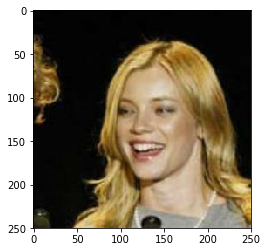

You look like a ... 
Cocker spaniel


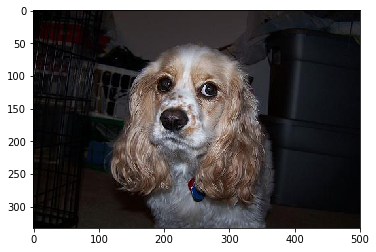


-----------------------------------------------------

hello, human!


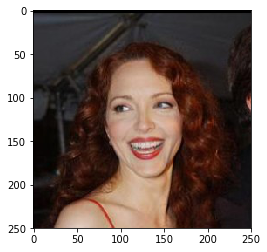

You look like a ... 
American water spaniel


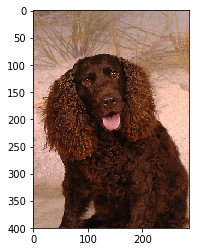


-----------------------------------------------------

hello, human!


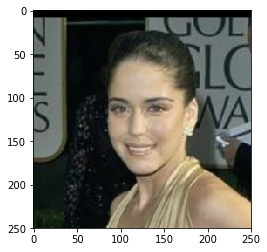

You look like a ... 
Lowchen


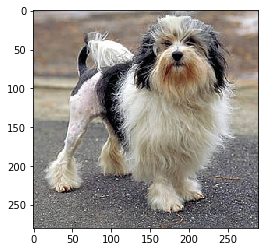


-----------------------------------------------------

hello, human!


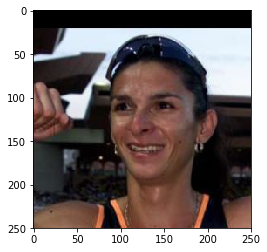

You look like a ... 
Pharaoh hound


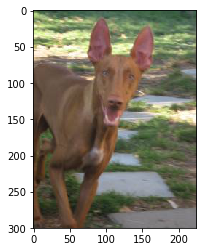


-----------------------------------------------------

hello, human!


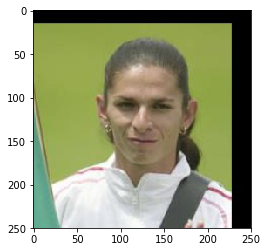

You look like a ... 
Bull terrier


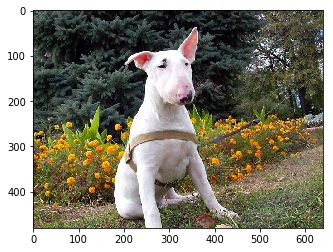


-----------------------------------------------------

hello, dog! Your breed is Affenpinscher


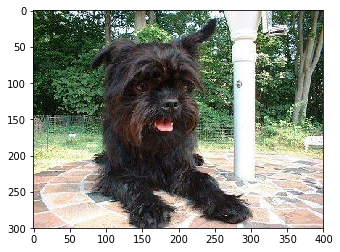

You look like a ... 
Affenpinscher

-----------------------------------------------------

hello, dog! Your breed is Afghan hound


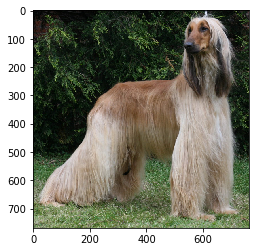

You look like a ... 
Afghan hound

-----------------------------------------------------

hello, dog! Your breed is Airedale terrier


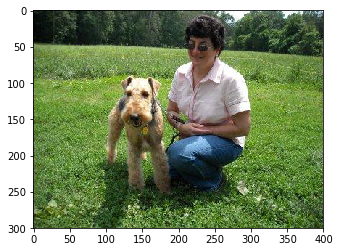

You look like a ... 
Airedale terrier

-----------------------------------------------------

hello, dog! Your breed is Akita


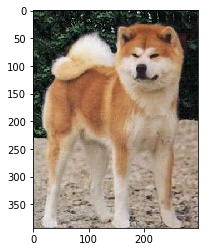

You look like a ... 
Akita

-----------------------------------------------------

hello, dog! Your breed is Alaskan malamute


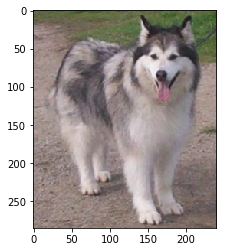

You look like a ... 
Alaskan malamute

-----------------------------------------------------

hello, dog! Your breed is American eskimo dog


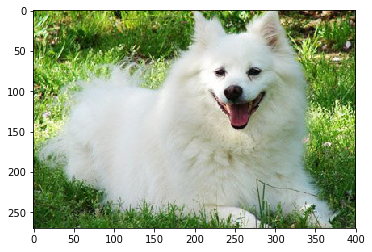

You look like a ... 
American eskimo dog

-----------------------------------------------------

hello, dog! Your breed is American foxhound


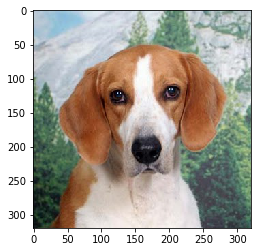

You look like a ... 
American foxhound

-----------------------------------------------------

hello, human!


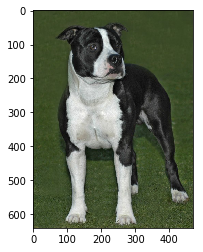

You look like a ... 
American staffordshire terrier


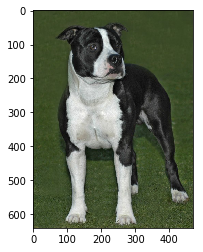


-----------------------------------------------------

hello, dog! Your breed is American water spaniel


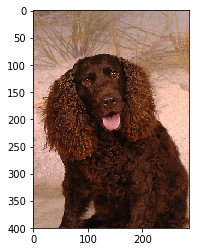

You look like a ... 
Irish water spaniel


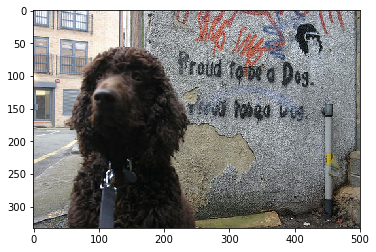


-----------------------------------------------------

hello, dog! Your breed is Anatolian shepherd dog


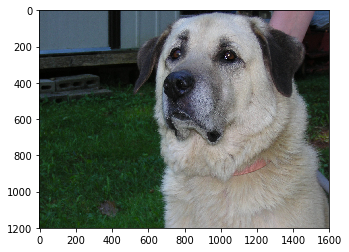

You look like a ... 
Anatolian shepherd dog

-----------------------------------------------------

hello, dog! Your breed is Australian cattle dog


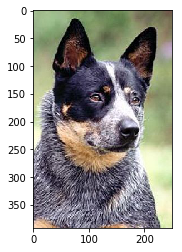

You look like a ... 
Australian cattle dog

-----------------------------------------------------

hello, dog! Your breed is Australian shepherd


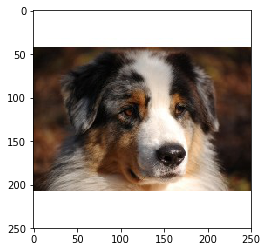

You look like a ... 
Australian shepherd

-----------------------------------------------------

hello, dog! Your breed is Australian terrier


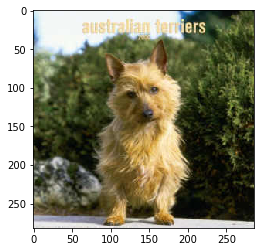

You look like a ... 
Australian terrier

-----------------------------------------------------

hello, human!


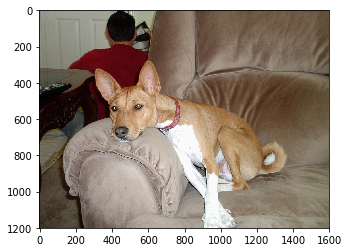

You look like a ... 
Basenji


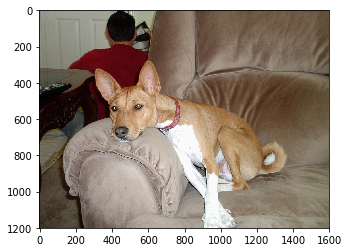


-----------------------------------------------------

hello, dog! Your breed is Basset hound


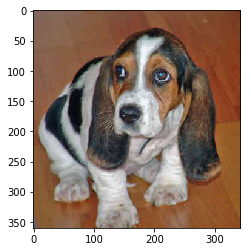

You look like a ... 
Basset hound

-----------------------------------------------------

hello, dog! Your breed is Beagle


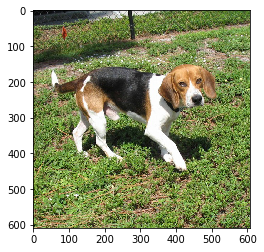

You look like a ... 
American foxhound


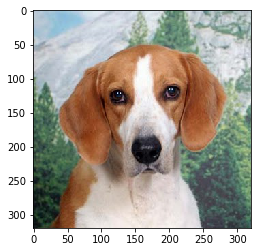


-----------------------------------------------------

hello, dog! Your breed is Bearded collie


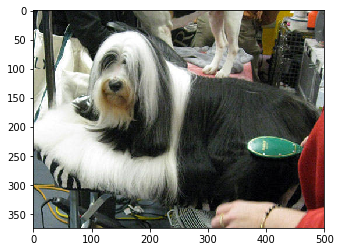

You look like a ... 
Bearded collie

-----------------------------------------------------

hello, dog! Your breed is Beauceron


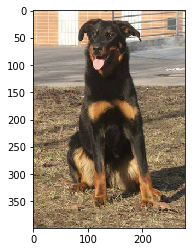

You look like a ... 
Beauceron

-----------------------------------------------------

hello, dog! Your breed is Bedlington terrier


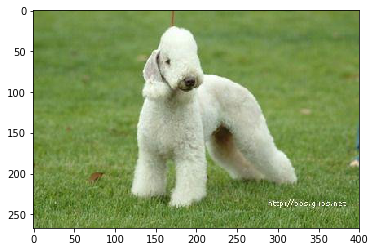

You look like a ... 
Bedlington terrier

-----------------------------------------------------

hello, dog! Your breed is Belgian malinois


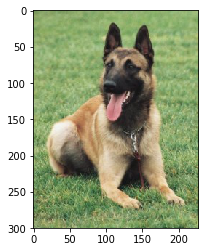

You look like a ... 
Belgian malinois

-----------------------------------------------------

hello, dog! Your breed is Belgian sheepdog


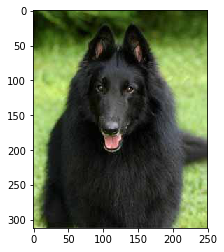

You look like a ... 
Belgian sheepdog

-----------------------------------------------------

hello, dog! Your breed is Belgian tervuren


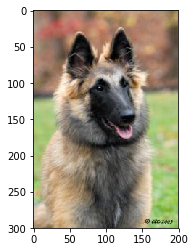

You look like a ... 
Belgian tervuren

-----------------------------------------------------

hello, dog! Your breed is Bernese mountain dog


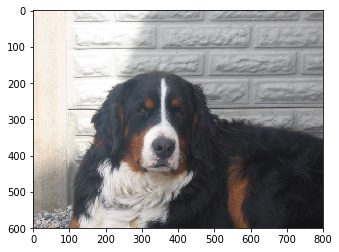

You look like a ... 
Bernese mountain dog

-----------------------------------------------------

hello, dog! Your breed is Bichon frise


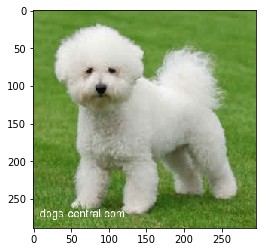

You look like a ... 
Bichon frise

-----------------------------------------------------

hello, dog! Your breed is Black and tan coonhound


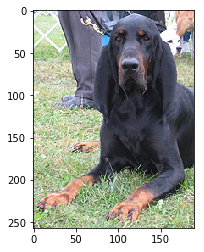

You look like a ... 
Labrador retriever


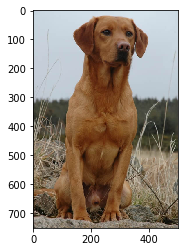


-----------------------------------------------------

hello, dog! Your breed is Black russian terrier


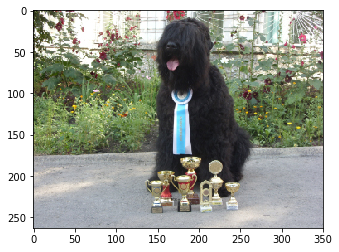

You look like a ... 
Black russian terrier

-----------------------------------------------------

hello, dog! Your breed is Bloodhound


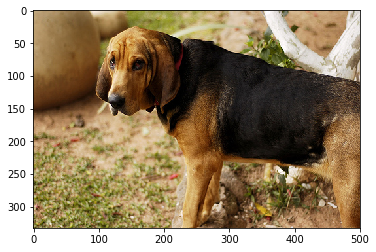

You look like a ... 
Bloodhound

-----------------------------------------------------

hello, dog! Your breed is Bluetick coonhound


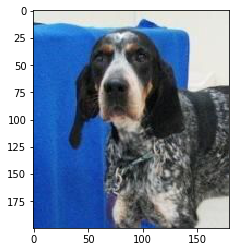

You look like a ... 
Bluetick coonhound

-----------------------------------------------------

hello, dog! Your breed is Border collie


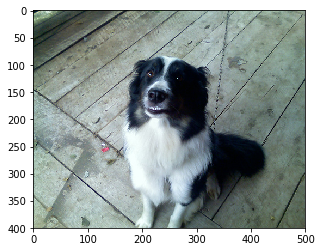

You look like a ... 
Border collie

-----------------------------------------------------

hello, dog! Your breed is Border terrier


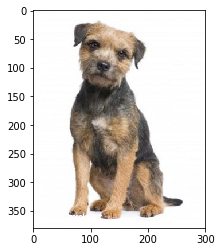

You look like a ... 
Border terrier

-----------------------------------------------------

hello, dog! Your breed is Borzoi


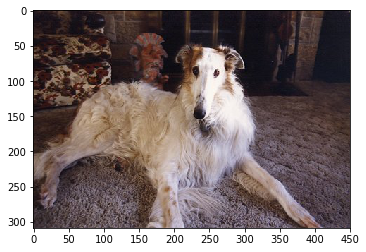

You look like a ... 
Borzoi

-----------------------------------------------------

hello, dog! Your breed is Boston terrier


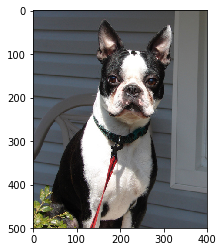

You look like a ... 
Boston terrier

-----------------------------------------------------

hello, dog! Your breed is Bouvier des flandres


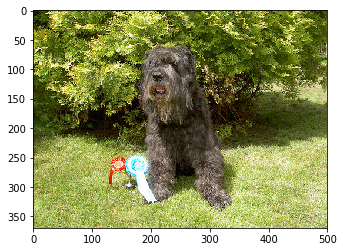

You look like a ... 
Bouvier des flandres

-----------------------------------------------------

hello, dog! Your breed is Boxer


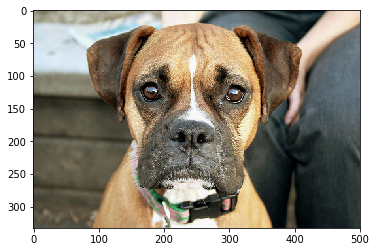

You look like a ... 
Boxer

-----------------------------------------------------

hello, dog! Your breed is Boykin spaniel


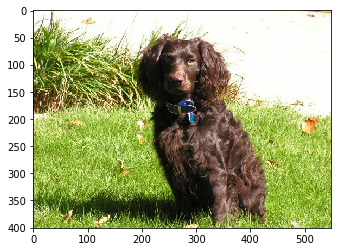

You look like a ... 
Boykin spaniel

-----------------------------------------------------

hello, dog! Your breed is Briard


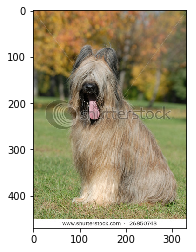

You look like a ... 
Briard

-----------------------------------------------------

hello, dog! Your breed is Brittany


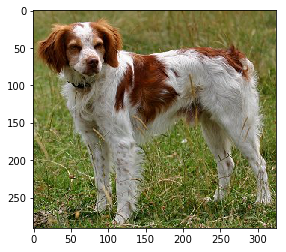

You look like a ... 
Brittany

-----------------------------------------------------

hello, dog! Your breed is Brussels griffon


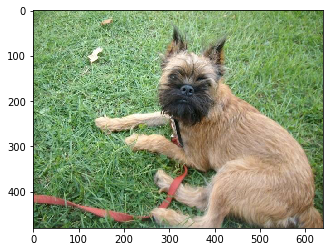

You look like a ... 
Brussels griffon

-----------------------------------------------------

hello, dog! Your breed is Bull terrier


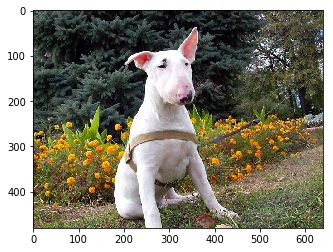

You look like a ... 
Bull terrier

-----------------------------------------------------

hello, dog! Your breed is Bulldog


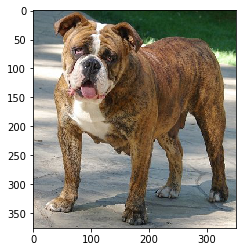

You look like a ... 
Bulldog

-----------------------------------------------------

hello, human!


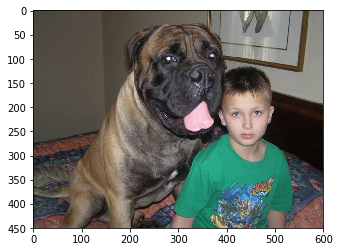

You look like a ... 
Mastiff


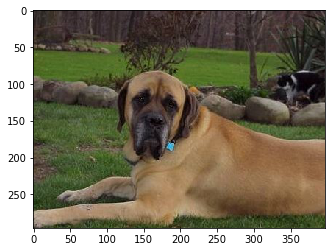


-----------------------------------------------------

hello, dog! Your breed is Cairn terrier


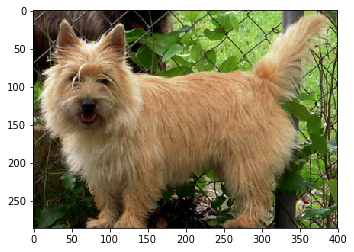

You look like a ... 
Cairn terrier

-----------------------------------------------------

hello, dog! Your breed is Canaan dog


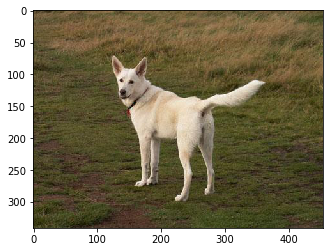

You look like a ... 
Canaan dog

-----------------------------------------------------

hello, dog! Your breed is Cane corso


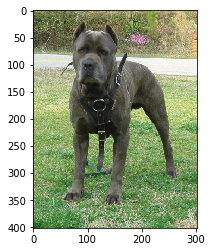

You look like a ... 
Cane corso

-----------------------------------------------------

hello, dog! Your breed is Cardigan welsh corgi


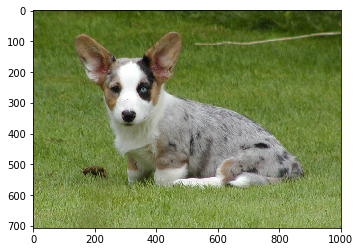

You look like a ... 
Cardigan welsh corgi

-----------------------------------------------------

hello, dog! Your breed is Cavalier king charles spaniel


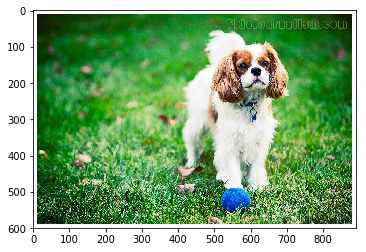

You look like a ... 
Cavalier king charles spaniel

-----------------------------------------------------

hello, dog! Your breed is Chesapeake bay retriever


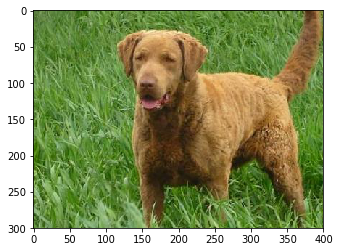

You look like a ... 
Chesapeake bay retriever

-----------------------------------------------------

hello, dog! Your breed is Chihuahua


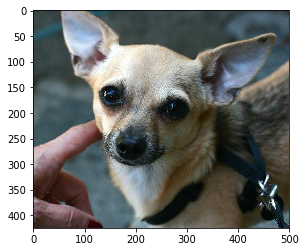

You look like a ... 
Chihuahua

-----------------------------------------------------

hello, dog! Your breed is Chinese crested


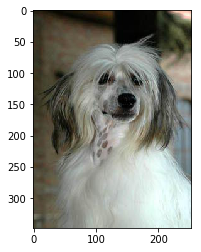

You look like a ... 
Chinese crested

-----------------------------------------------------

hello, dog! Your breed is Chinese shar-pei


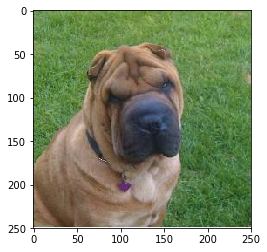

You look like a ... 
Chinese shar-pei

-----------------------------------------------------

hello, dog! Your breed is Chow chow


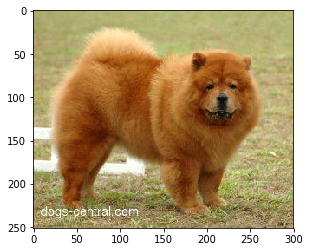

You look like a ... 
Chow chow

-----------------------------------------------------

hello, dog! Your breed is Clumber spaniel


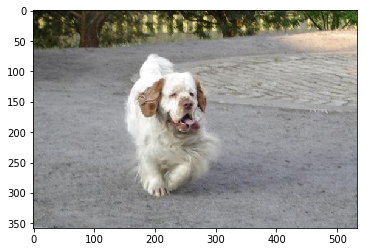

You look like a ... 
Clumber spaniel

-----------------------------------------------------

hello, dog! Your breed is Cocker spaniel


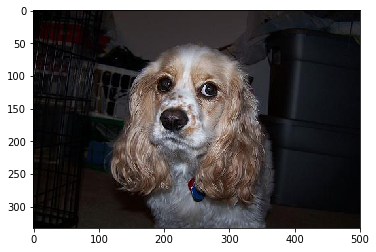

You look like a ... 
English cocker spaniel


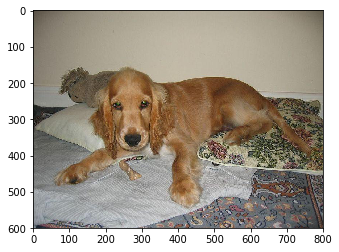


-----------------------------------------------------

hello, dog! Your breed is Collie


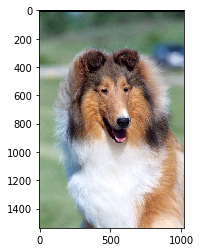

You look like a ... 
Collie

-----------------------------------------------------

hello, dog! Your breed is Curly-coated retriever


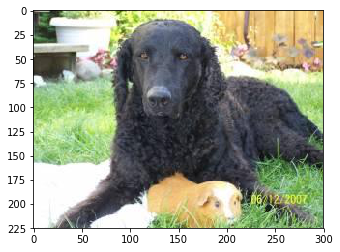

You look like a ... 
Curly-coated retriever

-----------------------------------------------------

hello, dog! Your breed is Dachshund


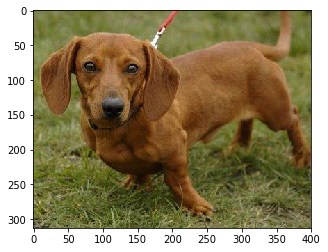

You look like a ... 
Dachshund

-----------------------------------------------------

hello, human!


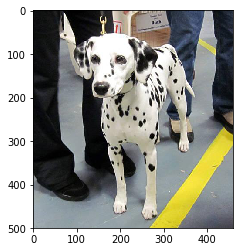

You look like a ... 
Dalmatian


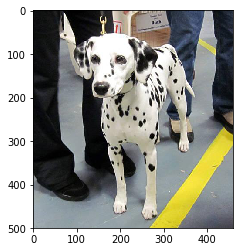


-----------------------------------------------------

hello, dog! Your breed is Dandie dinmont terrier


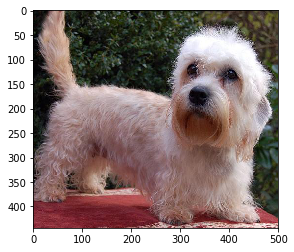

You look like a ... 
Dandie dinmont terrier

-----------------------------------------------------

hello, human!


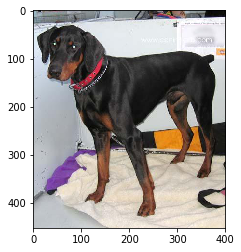

You look like a ... 
Doberman pinscher


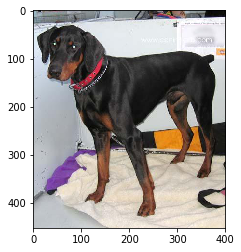


-----------------------------------------------------

hello, dog! Your breed is Dogue de bordeaux


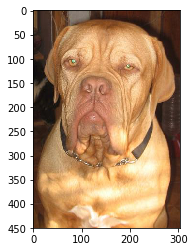

You look like a ... 
Dogue de bordeaux

-----------------------------------------------------

hello, dog! Your breed is English cocker spaniel


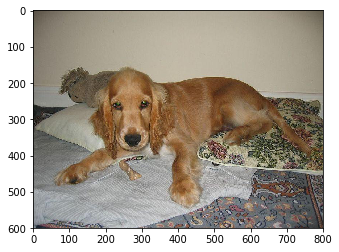

You look like a ... 
English cocker spaniel

-----------------------------------------------------

hello, dog! Your breed is English setter


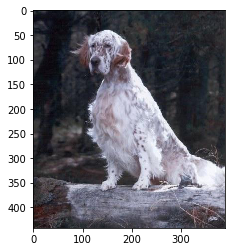

You look like a ... 
English setter

-----------------------------------------------------

hello, dog! Your breed is English springer spaniel


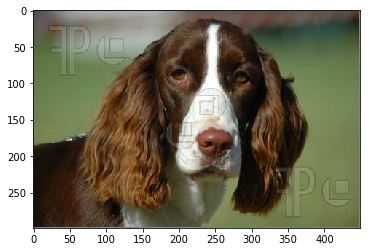

You look like a ... 
English springer spaniel

-----------------------------------------------------

hello, dog! Your breed is English toy spaniel


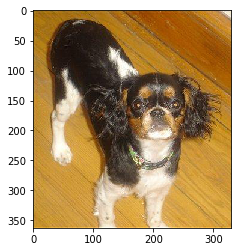

You look like a ... 
English toy spaniel

-----------------------------------------------------

hello, dog! Your breed is Entlebucher mountain dog


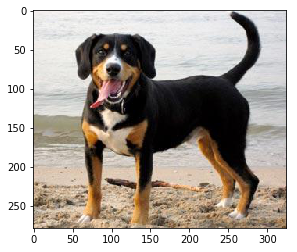

You look like a ... 
Entlebucher mountain dog

-----------------------------------------------------

hello, dog! Your breed is Field spaniel


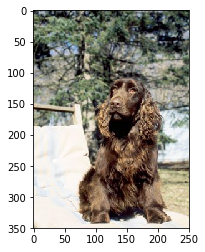

You look like a ... 
Field spaniel

-----------------------------------------------------

hello, dog! Your breed is Finnish spitz


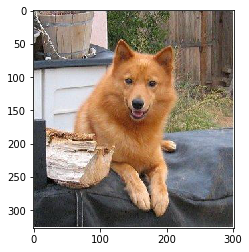

You look like a ... 
Finnish spitz

-----------------------------------------------------

hello, dog! Your breed is Flat-coated retriever


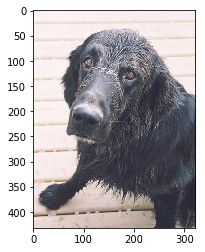

You look like a ... 
Flat-coated retriever

-----------------------------------------------------

hello, dog! Your breed is French bulldog


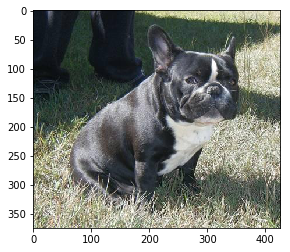

You look like a ... 
French bulldog

-----------------------------------------------------

hello, dog! Your breed is German pinscher


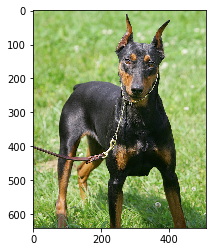

You look like a ... 
Manchester terrier


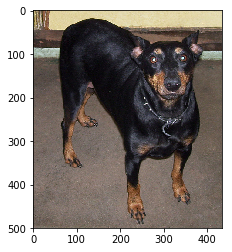


-----------------------------------------------------

hello, dog! Your breed is German shepherd dog


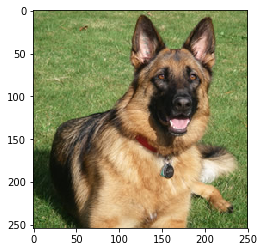

You look like a ... 
German shepherd dog

-----------------------------------------------------

hello, dog! Your breed is German shorthaired pointer


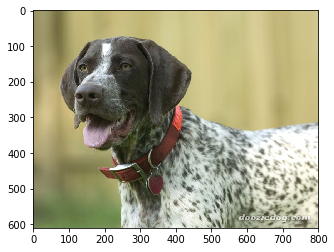

You look like a ... 
German shorthaired pointer

-----------------------------------------------------

hello, dog! Your breed is German wirehaired pointer


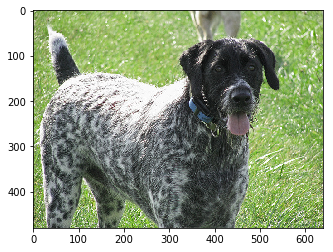

You look like a ... 
German wirehaired pointer

-----------------------------------------------------

hello, human!


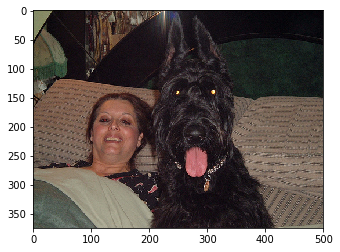

You look like a ... 
Giant schnauzer


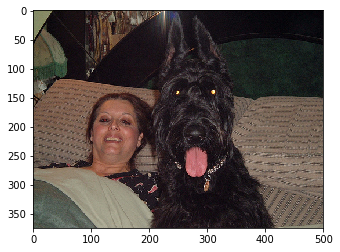


-----------------------------------------------------

hello, dog! Your breed is Glen of imaal terrier


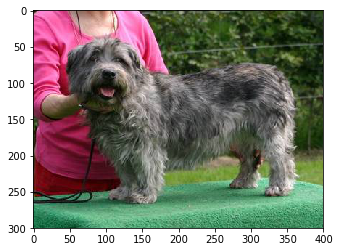

You look like a ... 
Glen of imaal terrier

-----------------------------------------------------

hello, human!


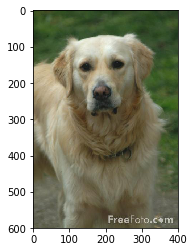

You look like a ... 
Golden retriever


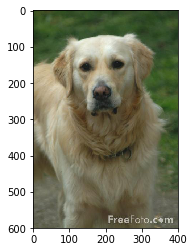


-----------------------------------------------------

hello, dog! Your breed is Gordon setter


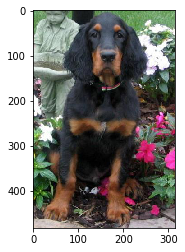

You look like a ... 
Gordon setter

-----------------------------------------------------

hello, human!


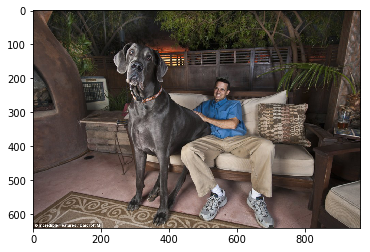

You look like a ... 
Dogue de bordeaux


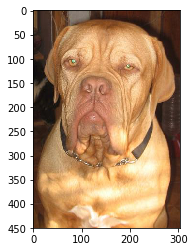


-----------------------------------------------------

hello, human!


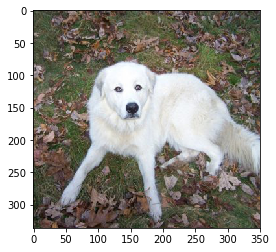

You look like a ... 
Great pyrenees


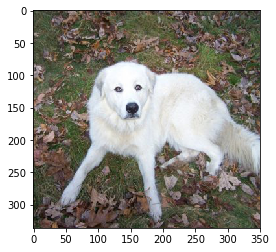


-----------------------------------------------------

hello, dog! Your breed is Greater swiss mountain dog


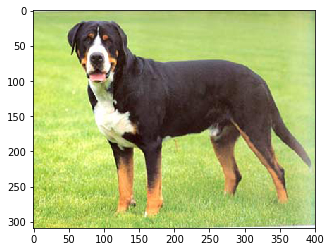

You look like a ... 
Greater swiss mountain dog

-----------------------------------------------------

hello, dog! Your breed is Greyhound


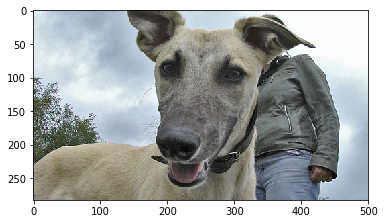

You look like a ... 
Greyhound

-----------------------------------------------------

hello, dog! Your breed is Havanese


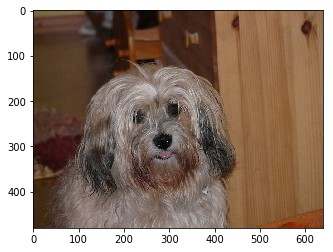

You look like a ... 
Havanese

-----------------------------------------------------

hello, dog! Your breed is Ibizan hound


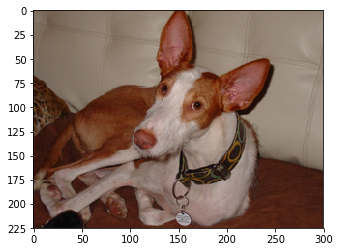

You look like a ... 
Ibizan hound

-----------------------------------------------------

hello, dog! Your breed is Icelandic sheepdog


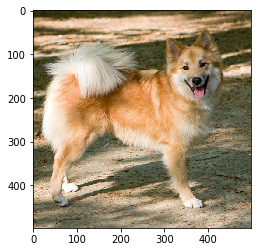

You look like a ... 
Icelandic sheepdog

-----------------------------------------------------

hello, dog! Your breed is Irish red and white setter


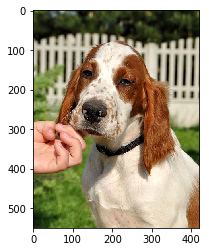

You look like a ... 
Irish red and white setter

-----------------------------------------------------

hello, dog! Your breed is Irish setter


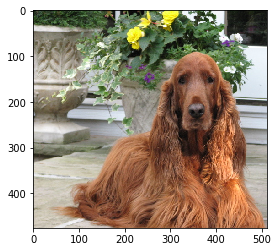

You look like a ... 
Irish setter

-----------------------------------------------------

hello, dog! Your breed is Irish terrier


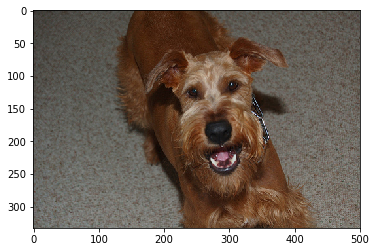

You look like a ... 
Irish terrier

-----------------------------------------------------

hello, dog! Your breed is Irish water spaniel


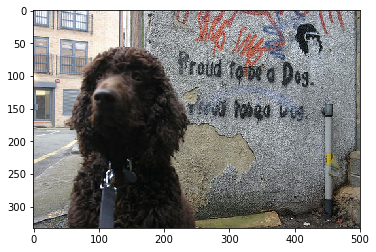

You look like a ... 
Irish water spaniel

-----------------------------------------------------

hello, dog! Your breed is Irish wolfhound


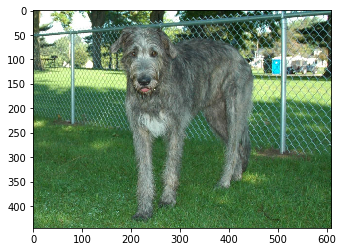

You look like a ... 
Irish wolfhound

-----------------------------------------------------

hello, dog! Your breed is Italian greyhound


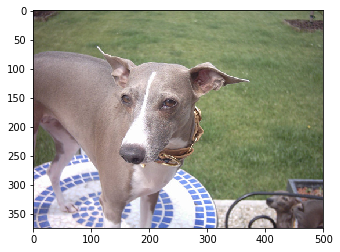

You look like a ... 
Italian greyhound

-----------------------------------------------------

hello, dog! Your breed is Japanese chin


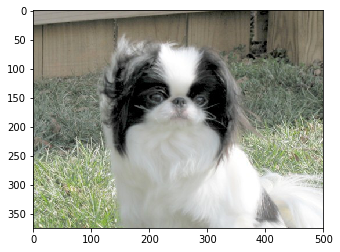

You look like a ... 
Japanese chin

-----------------------------------------------------

hello, dog! Your breed is Keeshond


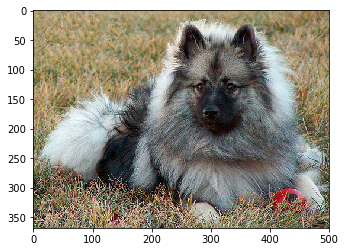

You look like a ... 
Keeshond

-----------------------------------------------------

hello, dog! Your breed is Kerry blue terrier


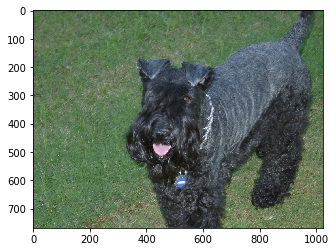

You look like a ... 
Kerry blue terrier

-----------------------------------------------------

hello, dog! Your breed is Komondor


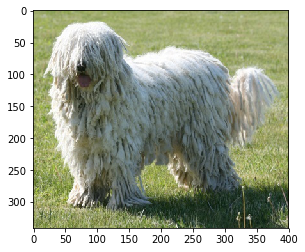

You look like a ... 
Komondor

-----------------------------------------------------

hello, dog! Your breed is Kuvasz


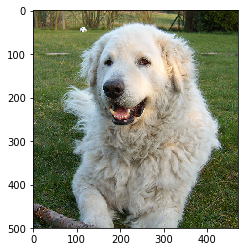

You look like a ... 
Golden retriever


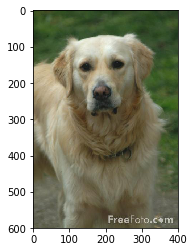


-----------------------------------------------------

hello, dog! Your breed is Labrador retriever


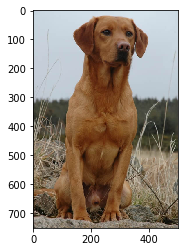

You look like a ... 
Labrador retriever

-----------------------------------------------------

hello, dog! Your breed is Lakeland terrier


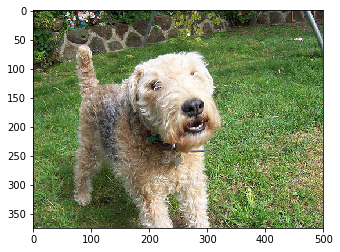

You look like a ... 
Lakeland terrier

-----------------------------------------------------

hello, human!


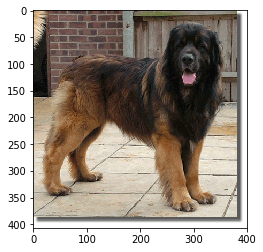

You look like a ... 
Leonberger


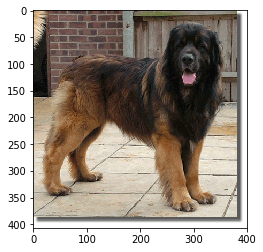


-----------------------------------------------------

hello, dog! Your breed is Lhasa apso


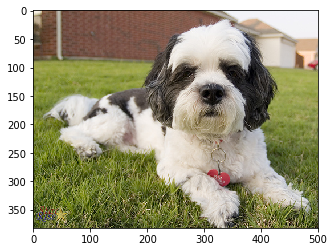

You look like a ... 
Lhasa apso

-----------------------------------------------------

hello, dog! Your breed is Lowchen


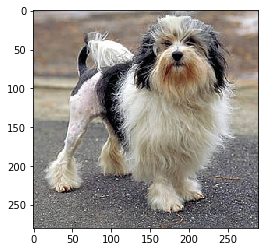

You look like a ... 
Lowchen

-----------------------------------------------------

hello, human!


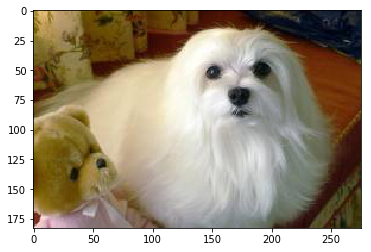

You look like a ... 
Maltese


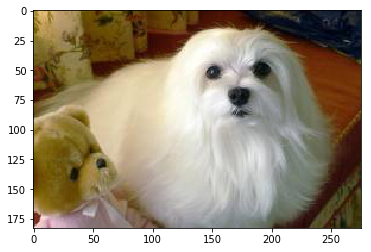


-----------------------------------------------------

hello, dog! Your breed is Manchester terrier


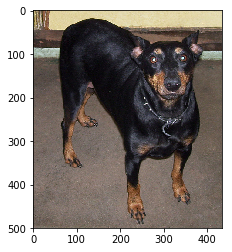

You look like a ... 
Manchester terrier

-----------------------------------------------------

hello, dog! Your breed is Mastiff


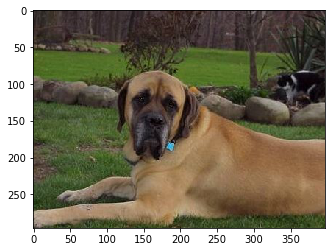

You look like a ... 
Mastiff

-----------------------------------------------------

hello, dog! Your breed is Miniature schnauzer


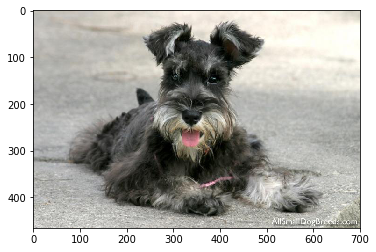

You look like a ... 
Miniature schnauzer

-----------------------------------------------------

hello, dog! Your breed is Neapolitan mastiff


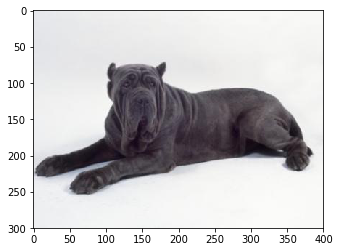

You look like a ... 
Neapolitan mastiff

-----------------------------------------------------

hello, dog! Your breed is Newfoundland


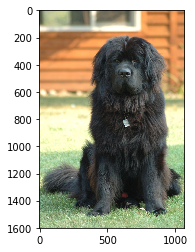

You look like a ... 
Newfoundland

-----------------------------------------------------

hello, dog! Your breed is Norfolk terrier


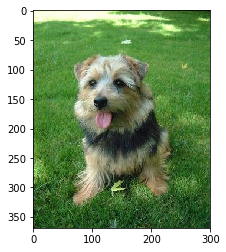

You look like a ... 
Norfolk terrier

-----------------------------------------------------

hello, dog! Your breed is Norwegian buhund


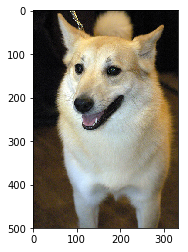

You look like a ... 
Norwegian buhund

-----------------------------------------------------

hello, dog! Your breed is Norwegian elkhound


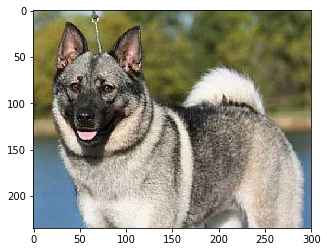

You look like a ... 
Norwegian elkhound

-----------------------------------------------------

hello, dog! Your breed is Norwegian lundehund


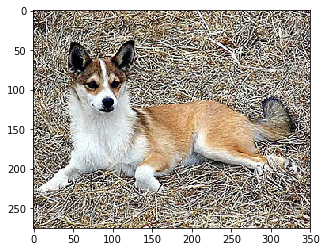

You look like a ... 
Norwegian lundehund

-----------------------------------------------------

hello, dog! Your breed is Norwich terrier


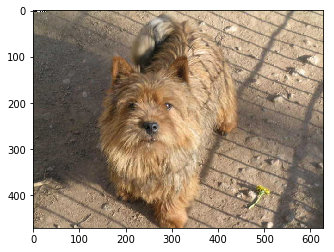

You look like a ... 
Norwich terrier

-----------------------------------------------------

hello, dog! Your breed is Nova scotia duck tolling retriever


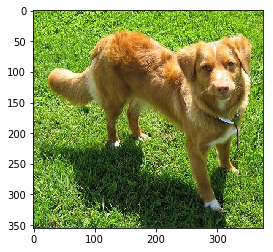

You look like a ... 
Nova scotia duck tolling retriever

-----------------------------------------------------

hello, dog! Your breed is Old english sheepdog


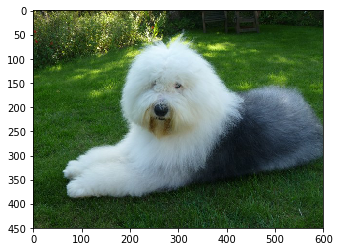

You look like a ... 
Old english sheepdog

-----------------------------------------------------

hello, dog! Your breed is Otterhound


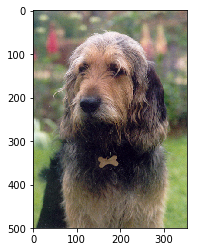

You look like a ... 
Otterhound

-----------------------------------------------------

hello, dog! Your breed is Papillon


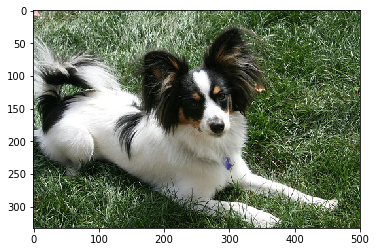

You look like a ... 
Papillon

-----------------------------------------------------

hello, dog! Your breed is Parson russell terrier


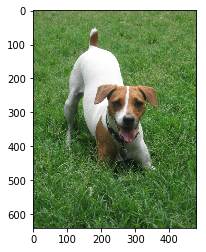

You look like a ... 
Parson russell terrier

-----------------------------------------------------

hello, dog! Your breed is Pekingese


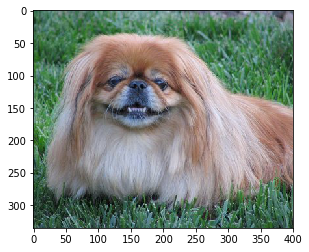

You look like a ... 
Pekingese

-----------------------------------------------------

hello, dog! Your breed is Pembroke welsh corgi


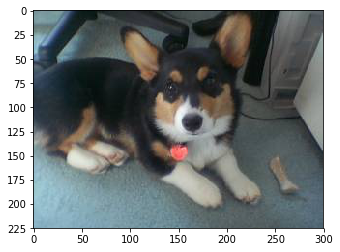

You look like a ... 
Pembroke welsh corgi

-----------------------------------------------------

hello, dog! Your breed is Petit basset griffon vendeen


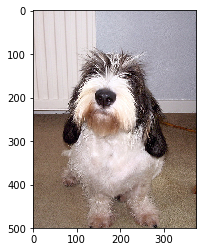

You look like a ... 
Petit basset griffon vendeen

-----------------------------------------------------

hello, dog! Your breed is Pharaoh hound


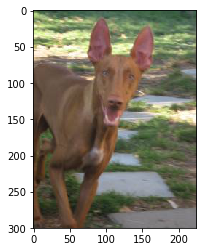

You look like a ... 
Pharaoh hound

-----------------------------------------------------

hello, dog! Your breed is Plott


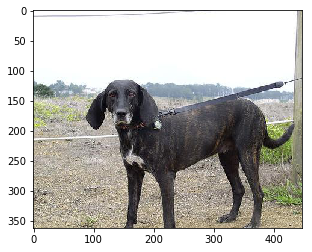

You look like a ... 
Plott

-----------------------------------------------------

hello, dog! Your breed is Pointer


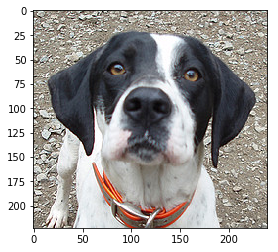

You look like a ... 
Pointer

-----------------------------------------------------

hello, dog! Your breed is Pomeranian


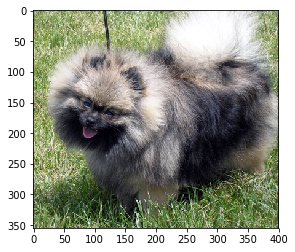

You look like a ... 
Pomeranian

-----------------------------------------------------

hello, dog! Your breed is Poodle


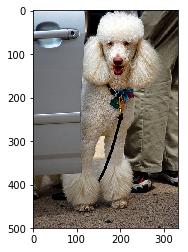

You look like a ... 
Poodle

-----------------------------------------------------

hello, dog! Your breed is Portuguese water dog


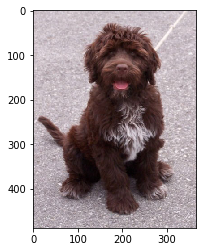

You look like a ... 
Wirehaired pointing griffon


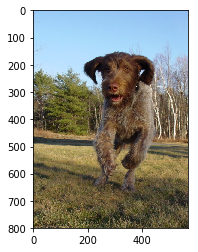


-----------------------------------------------------

hello, dog! Your breed is Saint bernard


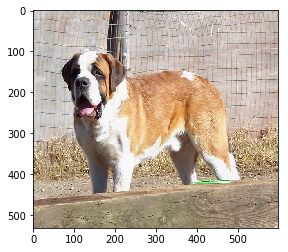

You look like a ... 
Saint bernard

-----------------------------------------------------

hello, dog! Your breed is Silky terrier


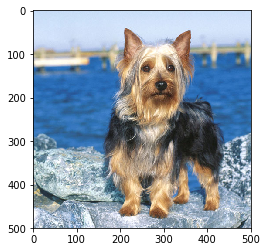

You look like a ... 
Silky terrier

-----------------------------------------------------

hello, dog! Your breed is Smooth fox terrier


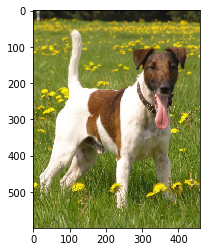

You look like a ... 
Smooth fox terrier

-----------------------------------------------------

hello, dog! Your breed is Tibetan mastiff


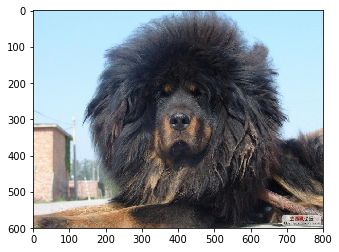

You look like a ... 
Tibetan mastiff

-----------------------------------------------------

hello, dog! Your breed is Welsh springer spaniel


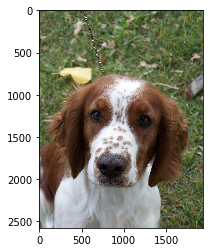

You look like a ... 
Welsh springer spaniel

-----------------------------------------------------

hello, dog! Your breed is Wirehaired pointing griffon


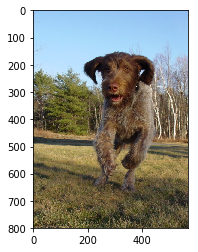

You look like a ... 
German wirehaired pointer


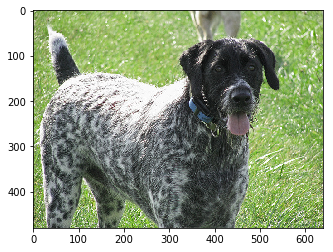


-----------------------------------------------------

hello, dog! Your breed is Xoloitzcuintli


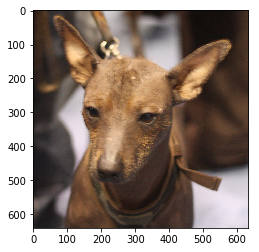

You look like a ... 
Xoloitzcuintli

-----------------------------------------------------

hello, dog! Your breed is Yorkshire terrier


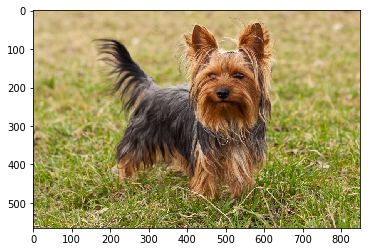

You look like a ... 
Yorkshire terrier

-----------------------------------------------------



In [221]:
## Execute your algorithm 

# get one of each breed
dog_files = []
for i in range(133):
    dog_files.append(get_path_to_breed(i))


for file in np.hstack((human_files[500:505], dog_files)):
    run_app(file)